# **Лабораторная работа**
*Naumov Anton (Any0019)*

*To contact me in telegram: @any0019*

В данном задании вашей задачей будет построить и обучить модель CycleGAN для задачи Img2Img.

---

Про задачу __Img2Img__:

- У вас есть 2 множества изображений ($A$ и $B$)
- Ваша задача - научиться превращать изображения из множества $A$ в изображения из множества $B$ и наоборот
- Бывают paired и unpaired множества
- В случае __paired__ множеств - для каждого изображения из $A$ существует конкретное изображение из $B$, в которое оно должно перейти (и наоборот). Примером такой пары множеств может быть (а) спутниковая фотграфия местности vs схематическая карта местности , (б) фотография фасада здания vs схема фасада здания , ...
- В случае __unpaired__ множеств - между множествами нет конкретных пар. Примером такой пары множеств может быть (а) фотографии с лошадьми vs фотографии с зебрами , (б) фотографии vs рисунки конкретного художника , ...

---

Про модель __CycleGAN__:

- Модель придумана для задачи Img2Img (в первую очередь unpaired версии) и основана на концепции GAN-ов
- В модели есть 2 генератора: $G_{A -> B}$ (задача которого - принимая на вход изображение из множества $A$ переводить его в изображение из множества $B$) и $G_{B -> A}$ (аналогично в другую сторону)
- Надо отметить что на вход генераторы не получают никакую дополнительную случайность, что делает обучение таких моделей проще
- В модели так же есть 2 дискриминатора: $D_{A}$ (задача которого - отличать реальные изображения из $A$ от сгенерированных с помощью $G_{B -> A}$ изображений) и $D_{B}$ (аналогично для $B$)
- Функцией ошибки будет, как и для GAN-ов, minmax игра между генераторами и дискриминаторами, но к ошибке генераторов добавится ещё и, так называемый, `cycle consistency loss`, который проверяет, что после двойного перехода изображения не меняются $G_{B -> A} \big( G_{A -> B} ( a ) \big) = a ; \forall a \in A$ и $G_{A -> B} \big( G_{B -> A} ( b ) \big) = b ; \forall b \in B$
- Так же можно добавлять или нет штраф за то, чтобы $G_{B -> A}$ не меняла изображения из $A$ и наоборот $G_{A -> B}$ не меняла изображения из $B$
- Оригинальная статья: https://arxiv.org/pdf/1703.10593.pdf

---

Ваша задача - ноутбук разбит на несколько частей, каждая со своими баллами

1. __Подготовка данных__ _(2 балла)_ --> требуется выбрать датасет для обучения (дано несколько на выбор) и составить пайплайн подготовки данных
2. __Составление модели__ _(6 баллов)_ --> требуется собрать нейросеть _(3 балла)_ и создать функции ошибки _(3 балла)_
3. __Подготовка обучения__ _(2 балла)_ --> требуется написать шаги обучения и валидации, визуализацию, а так же полный цикл обучения
4. __Обучение__ _(2 балла)_ --> требуется обучить модель
5. __Сбор своего датасета и обучение модели на нём__ _(3 балла)_ --> требуется собрать свой датасет и обучить на нём модель

***За наиболее интересные и качественные решения в пункте 5 так же предусмотрены дополнительные баллы***

In [2]:
import torch
import torch.nn as nn
import torch.nn.functional as F

from torch.utils.data import Dataset, DataLoader

from torchvision import datasets, transforms as tr

import numpy as np

import matplotlib.pyplot as plt
%matplotlib inline

# Для тёмной темы jupyter - уберите если не нужно
plt.style.use('dark_background')

from tqdm.auto import tqdm, trange

import os
import sys
import requests
import cv2

from dataclasses import dataclass

/home/t3fio/miniconda3/envs/ml/lib/python3.13/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# 1. Подготовка данных (___2 балла___)

## 1.1 Выбор и скачивание датасета

In [3]:
# dataset_folder = "/home/t3fio/nsu/ml/task_05/datasets/img2img"
# num_images_per_split = 5

# os.environ["dataset_folder"] = dataset_folder
# !mkdir -p {dataset_folder}

# # В этом цикле каждый из предложенных датасетов
# #  - скачивается
# #  - распаковывается
# #  - отрисовывается + meta
# #  - удаляется

# # Предлагается посмотреть на все предложенные варианты датасетов и затем оставить один,
# #  с которым захочется работать больше всего - закомментируйте (или удалите) все, кроме
# #  выбранного, а так же закомментируйте строчки с удалением скачанного датасета
# for dataset_name in [
#     # Unpaired
#     # "apple2orange",
#     # "summer2winter_yosemite",
#     # "horse2zebra",
#     # "monet2photo",
#     # "cezanne2photo",
#     "ukiyoe2photo",
#     # "vangogh2photo",
#     # Paired
#     # "maps",
#     # "facades",
# ]:
#     print(f"Dataset '{dataset_name}'")
#     url = f"http://efrosgans.eecs.berkeley.edu/cyclegan/datasets/{dataset_name}.zip"
#     download_path = os.path.join(dataset_folder, f"{dataset_name}.zip")
#     target_folder = os.path.join(dataset_folder, dataset_name)
    
#     # Чтобы bash вызовы знали соответствующие переменные
#     os.environ["url"] = url
#     os.environ["download_path"] = download_path
#     os.environ["target_folder"] = target_folder
    
#     print("Loading zip file...", end="")
#     # Проверяем что нет такого загруженого файла
#     if not os.path.isfile(download_path) or os.path.exists(target_folder):
#         # # Можно загрузить через requests библиотеку
#         # response = requests.get(url)
#         # open(download_path, "wb").write(response.content)
        
#         # Можно загрузить через wget
#         !wget {url} -O {download_path}
#     print(" --> done!")
    
#     print("Unziping...", end="")
#     # Распаковываем
#     if os.path.exists(target_folder):
#         !rm -r {target_folder}
#     !mkdir -p {dataset_folder}
#     !unzip -qq {download_path} -d {dataset_folder}
#     print(" --> done!")
    
#     # Удаляем zip-файл
#     !rm {download_path}
    
#     # Meta + Отрисовка
#     print(f"Provided splits: {os.listdir(target_folder)}")
#     # Удобный способ быстро получить датасет картинок с лэйблами, если картинки разложены по папкам в формате:
#     # root_folder/label_name/img.jpg
#     # (в нашем случае нет лэйблов, но картинки разложены в таком же формате, просто вместо label_name идёт
#     #  split_name: trainA/testA/trainB/testB)
#     dataset = datasets.ImageFolder(target_folder)

#     inds_to_show = {i: [] for i, _ in enumerate(dataset.classes)}
#     classes_full = 0
#     for dataset_ind in range(len(dataset)):
#         _, split_ind = dataset[dataset_ind]
#         if len(inds_to_show[split_ind]) == num_images_per_split:
#             continue
#         inds_to_show[split_ind].append(dataset_ind)
#         if len(inds_to_show[split_ind]) == num_images_per_split:
#             classes_full += 1
#         if classes_full == len(dataset.classes):
#             break

#     for split_name in sorted(dataset.classes):
#         split_ind = dataset.class_to_idx[split_name]
#         print(f"Split '{split_name}' of dataset '{dataset_name}'", end="")
#         split_folder = os.path.join(target_folder, split_name)
#         print(f" --> size: {len(os.listdir(split_folder))}")

#         plt.subplots(1, num_images_per_split, figsize=(5 * num_images_per_split, 5))
#         plt.suptitle(f"{dataset_name} ~ {split_name}", y=0.95)
#         for i, dataset_ind in enumerate(inds_to_show[split_ind]):
#             plt.subplot(1, num_images_per_split, i + 1)
#             plt.imshow(dataset[dataset_ind][0])
#             plt.xticks([])
#             plt.yticks([])
#         plt.show()
    
#     # Удаляем скачанный датасет
#     # !rm -r {target_folder}
    
#     print("\n----------------------------\n")

## 1.2 Dataset и Transforms

В папке `target_folder` находятся несколько папок со сплитами для соответствующего датасета, в каждой папке сплита находятся сами `.jpg` изображения.

Давайте составим их в удобном для нас виде в отдельные датасеты для каждого сплита без лэйблов.

Для получения картинок можно использовать 
```python
cv2.imread(img_path)[:, :, ::-1]  # каналы записаны в обратном порядке
```

In [4]:
# Выбранный выше и скачанный датасет
dataset_folder = "datasets/img2img/"
dataset_name = "ukiyoe2photo"
target_folder = os.path.join(dataset_folder, dataset_name)

# Класс для датасета изображений без лэйблов с применением трансформов
class ImageDatasetNoLabel(Dataset):
    def __init__(self, imgs_path, transforms=None):
        super(ImageDatasetNoLabel).__init__()
        self.images = []
        for filename in tqdm(os.listdir(imgs_path)):
            file_path = os.path.join(imgs_path, filename)
            if filename.lower().endswith(('.jpg')):
                img = cv2.imread(file_path)[:, :, ::-1]
                if transforms is not None:
                    img = transforms(img)
                self.images.append(img)

    def __getitem__(self, index):
        return self.images[index]
    
    def __len__(self):
        return len(self.images)

# Удобный класс для хранения всех наших датасетов
@dataclass
class DatasetsClass:
    train_a: ImageDatasetNoLabel
    train_b: ImageDatasetNoLabel
    test_a: ImageDatasetNoLabel
    test_b: ImageDatasetNoLabel


# Все датасеты без трансформов - чтобы посчитать статистики
ds = DatasetsClass(
    train_a=ImageDatasetNoLabel(os.path.join(target_folder, "trainA")),
    train_b=ImageDatasetNoLabel(os.path.join(target_folder, "trainB")),
    test_a=ImageDatasetNoLabel(os.path.join(target_folder, "testA")),
    test_b=ImageDatasetNoLabel(os.path.join(target_folder, "testB")),
)

100%|██████████| 751/751 [00:00<00:00, 1106.25it/s]


In [5]:
def get_channel_statistics(dataset):
    """
    Функция для получения поканальных статистик (среднее и отклонение) по датасету
    """
    means = []
    for img in tqdm(dataset):
        img = img/255
        means.append(np.mean(np.mean(img, axis=0), axis=0))
    channel_mean = np.mean(means, axis=0)
    stds = []
    for img in tqdm(dataset):
        var = np.mean((img/255 - channel_mean)**2, axis=0)
        stds.append(np.mean(var, axis=0))
    channel_std = np.sqrt(np.mean(stds, axis=0))
    return channel_mean, channel_std

# Поканальное среднее и отклонение для A
channel_mean_a, channel_std_a = get_channel_statistics(ds.train_a)
print(channel_mean_a, channel_std_a)

# Поканальное среднее и отклонение для B
channel_mean_b, channel_std_b = get_channel_statistics(ds.train_b)
print(channel_mean_b, channel_std_b)

100%|██████████| 562/562 [00:00<00:00, 1098.50it/s]


[0.64137167 0.59759022 0.5261496 ] [0.28112191 0.25893933 0.2349972 ]


100%|██████████| 6287/6287 [00:05<00:00, 1060.97it/s]

[0.41229027 0.40928956 0.39267376] [0.27109754 0.24869304 0.27782148]


In [6]:
from torchvision.transforms import v2
from sklearn.preprocessing import minmax_scale

/tmp/ipykernel_25621/2585991177.py:25: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  (img.reshape(3, -1) + mean[:, None]) * std[:, None],
/tmp/ipykernel_25621/2585991177.py:25: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  (img.reshape(3, -1) + mean[:, None]) * std[:, None],
/tmp/ipykernel_25621/2585991177.py:25: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  (img.reshape(3, -1) + mean[:, None]) * std[:, None],
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.0000000000000002].
/tmp/ipykernel_25621/2585991177.py:25: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated

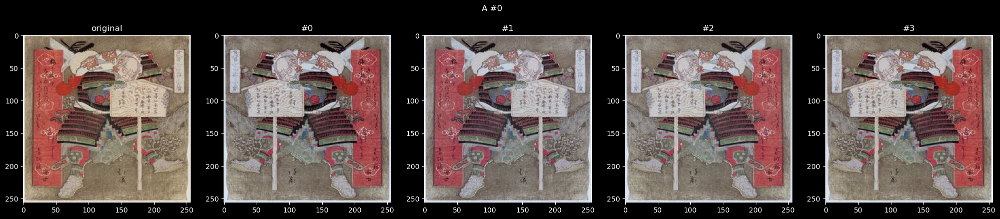

/tmp/ipykernel_25621/2585991177.py:25: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  (img.reshape(3, -1) + mean[:, None]) * std[:, None],
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.0000000000000002].


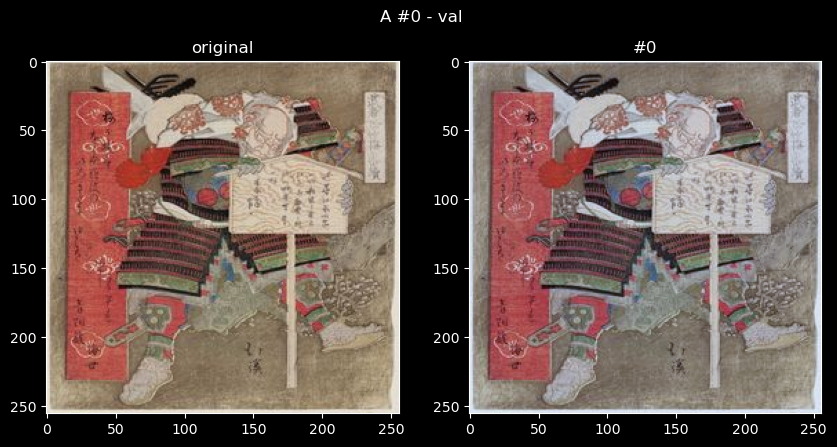

/tmp/ipykernel_25621/2585991177.py:25: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  (img.reshape(3, -1) + mean[:, None]) * std[:, None],
/tmp/ipykernel_25621/2585991177.py:25: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  (img.reshape(3, -1) + mean[:, None]) * std[:, None],
/tmp/ipykernel_25621/2585991177.py:25: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  (img.reshape(3, -1) + mean[:, None]) * std[:, None],
/tmp/ipykernel_25621/2585991177.py:25: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  (img.reshape(3, -1) + mean[:, None]) * std[:, None],


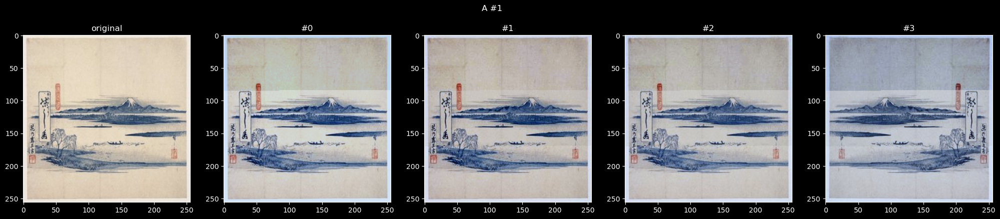

/tmp/ipykernel_25621/2585991177.py:25: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  (img.reshape(3, -1) + mean[:, None]) * std[:, None],
/tmp/ipykernel_25621/2585991177.py:25: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  (img.reshape(3, -1) + mean[:, None]) * std[:, None],
/tmp/ipykernel_25621/2585991177.py:25: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  (img.reshape(3, -1) + mean[:, None]) * std[:, None],
/tmp/ipykernel_25621/2585991177.py:25: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  (img.reshape(3, -1) + mean[:, None]) * std[:, None],


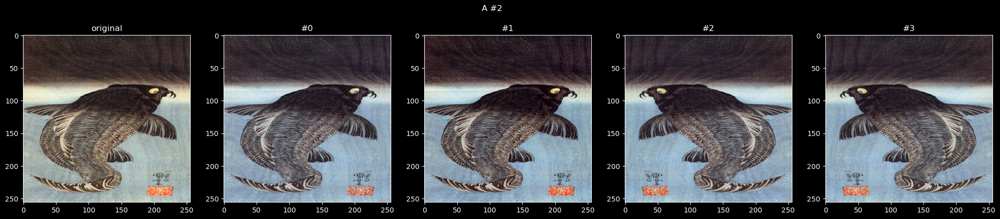

/tmp/ipykernel_25621/2585991177.py:25: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  (img.reshape(3, -1) + mean[:, None]) * std[:, None],
/tmp/ipykernel_25621/2585991177.py:25: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  (img.reshape(3, -1) + mean[:, None]) * std[:, None],
/tmp/ipykernel_25621/2585991177.py:25: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  (img.reshape(3, -1) + mean[:, None]) * std[:, None],
/tmp/ipykernel_25621/2585991177.py:25: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  (img.reshape(3, -1) + mean[:, None]) * std[:, None],


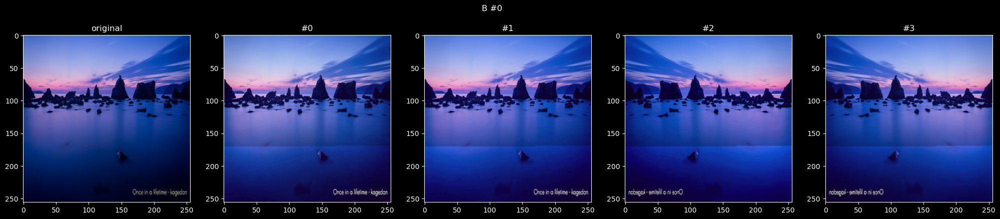

/tmp/ipykernel_25621/2585991177.py:25: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  (img.reshape(3, -1) + mean[:, None]) * std[:, None],


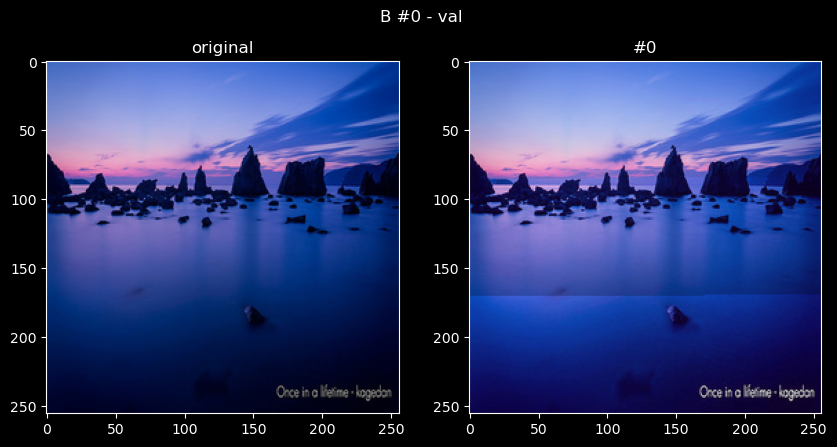

/tmp/ipykernel_25621/2585991177.py:25: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  (img.reshape(3, -1) + mean[:, None]) * std[:, None],
/tmp/ipykernel_25621/2585991177.py:25: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  (img.reshape(3, -1) + mean[:, None]) * std[:, None],
/tmp/ipykernel_25621/2585991177.py:25: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  (img.reshape(3, -1) + mean[:, None]) * std[:, None],
/tmp/ipykernel_25621/2585991177.py:25: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  (img.reshape(3, -1) + mean[:, None]) * std[:, None],


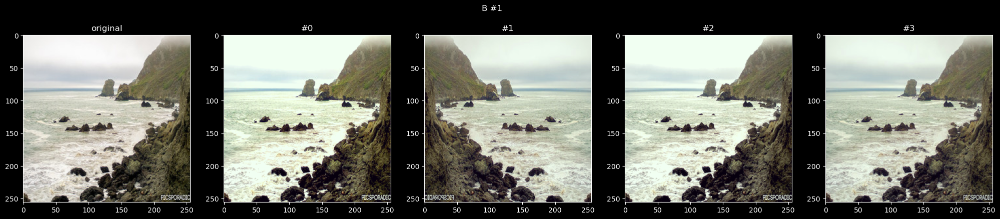

/tmp/ipykernel_25621/2585991177.py:25: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  (img.reshape(3, -1) + mean[:, None]) * std[:, None],
/tmp/ipykernel_25621/2585991177.py:25: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  (img.reshape(3, -1) + mean[:, None]) * std[:, None],
/tmp/ipykernel_25621/2585991177.py:25: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  (img.reshape(3, -1) + mean[:, None]) * std[:, None],
/tmp/ipykernel_25621/2585991177.py:25: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  (img.reshape(3, -1) + mean[:, None]) * std[:, None],


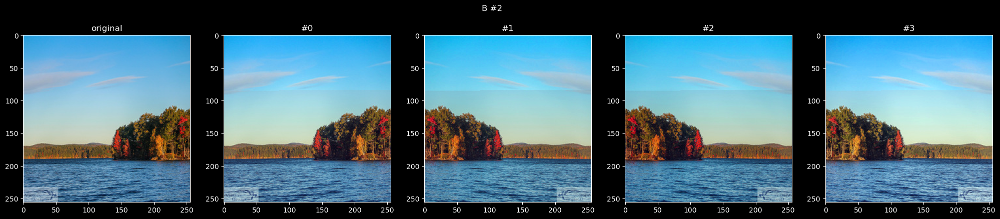

In [7]:
# Функция для получения train и val transform-ов, а так же функции для де-нормализации изображения
def get_transforms(mean, std, random_crop_size, p):
    train_transform = tr.Compose([
        tr.ToPILImage(),
        tr.RandomApply([
            tr.ColorJitter(0.2, 0.2, 0.2, 0.01)  # Изменение яркости, контраста и т.д.
        ], p=0.8),
        v2.RandomCrop(size=random_crop_size),
        v2.RandomHorizontalFlip(p=p),
        tr.ToTensor(),
        tr.Normalize(mean=mean, std=std),
    ])
    
    val_transform = tr.Compose([
        tr.ToPILImage(),
        tr.ToTensor(),
        tr.Normalize(mean=mean, std=std),
    ])
    
    def de_normalize(img, normalized = True):
        with torch.no_grad():
            if normalized:
                img = img.cpu().permute(1,2,0)
                return minmax_scale(
                    (img.reshape(3, -1) + mean[:, None]) * std[:, None],
                    feature_range=(0., 1.),
                    axis=1,
                ).reshape(*img.shape)
            return img

    
    return train_transform, val_transform, de_normalize


# Ваши гиперпараметры
hyperparams = dict(
    random_crop_size = 256,
    p = 0.5
)
# transform-ы для A и B
train_transform_a, val_transform_a, de_normalize_a = get_transforms(channel_mean_a, channel_std_a, **hyperparams)
train_transform_b, val_transform_b, de_normalize_b = get_transforms(channel_mean_b, channel_std_b, **hyperparams)


# Функция для визуализации transform-ов
def show_examples(dataset, transform, de_norm, num_per_image=3, image_index=0, title=""):
    fig, ax = plt.subplots(1, 1 + num_per_image, figsize=(5 * (1 + num_per_image), 5))
    
    image = dataset[image_index]
    
    plt.suptitle(title, y=0.95)

    plt.subplot(1, 1 + num_per_image, 1)
    plt.imshow(image)
    plt.title("original")

    for i in range(num_per_image):
        plt.subplot(1, 1 + num_per_image, i + 2)
        plt.title(f"#{i}")
        plt.imshow(de_norm(transform(image)))
    plt.show()

# Проверка на адекватность
show_examples(ds.train_a, train_transform_a, de_normalize_a, num_per_image=4, image_index=0, title="A #0")
show_examples(ds.train_a, val_transform_a, de_normalize_a, num_per_image=1, image_index=0, title="A #0 - val")
show_examples(ds.train_a, train_transform_a, de_normalize_a, num_per_image=4, image_index=1, title="A #1")
show_examples(ds.train_a, train_transform_a, de_normalize_a, num_per_image=4, image_index=2, title="A #2")
show_examples(ds.train_b, train_transform_b, de_normalize_b, num_per_image=4, image_index=0, title="B #0")
show_examples(ds.train_b, val_transform_b, de_normalize_b, num_per_image=1, image_index=0, title="B #0 - val")
show_examples(ds.train_b, train_transform_b, de_normalize_b, num_per_image=4, image_index=1, title="B #1")
show_examples(ds.train_b, train_transform_b, de_normalize_b, num_per_image=4, image_index=2, title="B #2")

In [8]:
# Все датасеты с трансформами
ds = DatasetsClass(
    train_a=ImageDatasetNoLabel(
        os.path.join(target_folder, "trainA"),
        transforms=train_transform_a,
    ),
    train_b=ImageDatasetNoLabel(
        os.path.join(target_folder, "trainB"),
        transforms=val_transform_b,
    ),
    test_a=ImageDatasetNoLabel(
        os.path.join(target_folder, "testA"),
        transforms=val_transform_a,
    ),
    test_b=ImageDatasetNoLabel(
        os.path.join(target_folder, "testB"),
        transforms=val_transform_b,
    ),
)

100%|██████████| 751/751 [00:01<00:00, 416.43it/s]


## 1.3 DataLoader

In [9]:
@dataclass
class DataLoadersClass:
    train_a: DataLoader
    train_b: DataLoader
    test_a: DataLoader
    test_b: DataLoader

batch_size = 10

dataloaders = DataLoadersClass(
    train_a=DataLoader(
        dataset=ds.train_a,
        batch_size=batch_size,
        shuffle=True,
        drop_last=True,
    ),
    train_b=DataLoader(
        dataset=ds.train_b,
        batch_size=batch_size,
        shuffle=True,
        drop_last=True,
    ),
    test_a=DataLoader(
        dataset=ds.test_a,
        batch_size=batch_size,
        shuffle=False,
        drop_last=True,
    ),
    test_b=DataLoader(
        dataset=ds.test_b,
        batch_size=batch_size,
        shuffle=False,
        drop_last=True,
    ),
)

# 2. Модель (___6 баллов___)

## 2.0 Любые вспомогательные модули и классы

In [10]:
import functools

In [11]:
class ResnetBlock(nn.Module):
    """Define a Resnet block"""

    def __init__(self, dim, padding_type, norm_layer, use_dropout, use_bias):
        """Initialize the Resnet block

        A resnet block is a conv block with skip connections
        We construct a conv block with build_conv_block function,
        and implement skip connections in <forward> function.
        Original Resnet paper: https://arxiv.org/pdf/1512.03385.pdf
        """
        super(ResnetBlock, self).__init__()
        self.conv_block = self.build_conv_block(dim, padding_type, norm_layer, use_dropout, use_bias)

    def build_conv_block(self, dim, padding_type, norm_layer, use_dropout, use_bias):
        """Construct a convolutional block.

        Parameters:
            dim (int)           -- the number of channels in the conv layer.
            padding_type (str)  -- the name of padding layer: reflect | replicate | zero
            norm_layer          -- normalization layer
            use_dropout (bool)  -- if use dropout layers.
            use_bias (bool)     -- if the conv layer uses bias or not

        Returns a conv block (with a conv layer, a normalization layer, and a non-linearity layer (ReLU))
        """
        conv_block = []
        p = 0
        if padding_type == 'reflect':
            conv_block += [nn.ReflectionPad2d(1)]
        elif padding_type == 'replicate':
            conv_block += [nn.ReplicationPad2d(1)]
        elif padding_type == 'zero':
            p = 1
        else:
            raise NotImplementedError('padding [%s] is not implemented' % padding_type)

        conv_block += [nn.Conv2d(dim, dim, kernel_size=3, padding=p, bias=use_bias), norm_layer(dim), nn.ReLU(True)]
        if use_dropout:
            conv_block += [nn.Dropout(0.5)]

        p = 0
        if padding_type == 'reflect':
            conv_block += [nn.ReflectionPad2d(1)]
        elif padding_type == 'replicate':
            conv_block += [nn.ReplicationPad2d(1)]
        elif padding_type == 'zero':
            p = 1
        else:
            raise NotImplementedError('padding [%s] is not implemented' % padding_type)
        conv_block += [nn.Conv2d(dim, dim, kernel_size=3, padding=p, bias=use_bias), norm_layer(dim)]

        return nn.Sequential(*conv_block)

    def forward(self, x):
        """Forward function (with skip connections)"""
        out = x + self.conv_block(x)  # add skip connections
        return out


In [12]:
# Просто адское время обучения модели из статьи, использовать не буду

class ResnetGenerator(nn.Module):
    """Resnet-based generator that consists of Resnet blocks between a few downsampling/upsampling operations.

    We adapt Torch code and idea from Justin Johnson's neural style transfer project(https://github.com/jcjohnson/fast-neural-style)
    """

    def __init__(self, input_nc, output_nc, ngf=64, norm_layer=nn.BatchNorm2d, use_dropout=False, n_blocks=6, padding_type='reflect'):
        """Construct a Resnet-based generator

        Parameters:
            input_nc (int)      -- the number of channels in input images
            output_nc (int)     -- the number of channels in output images
            ngf (int)           -- the number of filters in the last conv layer
            norm_layer          -- normalization layer
            use_dropout (bool)  -- if use dropout layers
            n_blocks (int)      -- the number of ResNet blocks
            padding_type (str)  -- the name of padding layer in conv layers: reflect | replicate | zero
        """
        assert(n_blocks >= 0)
        super(ResnetGenerator, self).__init__()
        if type(norm_layer) == functools.partial:
            use_bias = norm_layer.func == nn.InstanceNorm2d
        else:
            use_bias = norm_layer == nn.InstanceNorm2d

        model = [nn.ReflectionPad2d(3),
                 nn.Conv2d(input_nc, ngf, kernel_size=7, padding=0, bias=use_bias),
                 norm_layer(ngf),
                 nn.ReLU(True)]

        n_downsampling = 2
        for i in range(n_downsampling):  # add downsampling layers
            mult = 2 ** i
            model += [nn.Conv2d(ngf * mult, ngf * mult * 2, kernel_size=3, stride=2, padding=1, bias=use_bias),
                      norm_layer(ngf * mult * 2),
                      nn.ReLU(True)]

        mult = 2 ** n_downsampling
        for i in range(n_blocks):       # add ResNet blocks

            model += [ResnetBlock(ngf * mult, padding_type=padding_type, norm_layer=norm_layer, use_dropout=use_dropout, use_bias=use_bias)]

        for i in range(n_downsampling):  # add upsampling layers
            mult = 2 ** (n_downsampling - i)
            model += [nn.ConvTranspose2d(ngf * mult, int(ngf * mult / 2),
                                         kernel_size=3, stride=2,
                                         padding=1, output_padding=1,
                                         bias=use_bias),
                      norm_layer(int(ngf * mult / 2)),
                      nn.ReLU(True)]
        model += [nn.ReflectionPad2d(3)]
        model += [nn.Conv2d(ngf, output_nc, kernel_size=7, padding=0)]
        model += [nn.Tanh()]

        self.model = nn.Sequential(*model)

    def forward(self, input):
        """Standard forward"""
        return self.model(input)

In [13]:
# Дискриминаторы обучаются быстро.. почему бы и не использовать?
class NLayerDiscriminator(nn.Module):
    """Defines a PatchGAN discriminator"""

    def __init__(self, input_nc, ndf=64, n_layers=3, norm_layer=nn.BatchNorm2d):
        """Construct a PatchGAN discriminator

        Parameters:
            input_nc (int)  -- the number of channels in input images
            ndf (int)       -- the number of filters in the last conv layer
            n_layers (int)  -- the number of conv layers in the discriminator
            norm_layer      -- normalization layer
        """
        super(NLayerDiscriminator, self).__init__()
        if type(norm_layer) == functools.partial:  # no need to use bias as BatchNorm2d has affine parameters
            use_bias = norm_layer.func == nn.InstanceNorm2d
        else:
            use_bias = norm_layer == nn.InstanceNorm2d

        kw = 4
        padw = 1
        sequence = [nn.Conv2d(input_nc, ndf, kernel_size=kw, stride=2, padding=padw), nn.LeakyReLU(0.2, True)]
        nf_mult = 1
        nf_mult_prev = 1
        for n in range(1, n_layers):  # gradually increase the number of filters
            nf_mult_prev = nf_mult
            nf_mult = min(2 ** n, 8)
            sequence += [
                nn.Conv2d(ndf * nf_mult_prev, ndf * nf_mult, kernel_size=kw, stride=2, padding=padw, bias=use_bias),
                norm_layer(ndf * nf_mult),
                nn.LeakyReLU(0.2, True)
            ]

        nf_mult_prev = nf_mult
        nf_mult = min(2 ** n_layers, 8)
        sequence += [
            nn.Conv2d(ndf * nf_mult_prev, ndf * nf_mult, kernel_size=kw, stride=1, padding=padw, bias=use_bias),
            norm_layer(ndf * nf_mult),
            nn.LeakyReLU(0.2, True)
        ]

        sequence += [nn.Conv2d(ndf * nf_mult, 1, kernel_size=kw, stride=1, padding=padw)]  # output 1 channel prediction map
        self.model = nn.Sequential(*sequence)

    def forward(self, input):
        """Standard forward."""
        return self.model(input)

In [14]:
# Vibe coding, но вроде бы всё логично
class SimpleGenerator(nn.Module):
    def __init__(self, input_nc=3, output_nc=3, ngf=64):
        super(SimpleGenerator, self).__init__()
        
        # Энкодер
        self.enc1 = nn.Sequential(
            nn.Conv2d(input_nc, ngf, 4, 2, 1),
            nn.LeakyReLU(0.2)
        )
        self.enc2 = nn.Sequential(
            nn.Conv2d(ngf, ngf*2, 4, 2, 1),
            nn.InstanceNorm2d(ngf*2),
            nn.LeakyReLU(0.2)
        )
        
        # Блоки в середине
        self.mid = nn.Sequential(
            nn.Conv2d(ngf*2, ngf*2, 3, 1, 1),
            nn.InstanceNorm2d(ngf*2),
            nn.ReLU()
        )
        
        # Декодер
        self.dec1 = nn.Sequential(
            nn.ConvTranspose2d(ngf*2, ngf, 4, 2, 1),
            nn.InstanceNorm2d(ngf),
            nn.ReLU()
        )
        self.dec2 = nn.Sequential(
            nn.ConvTranspose2d(ngf, output_nc, 4, 2, 1),
            nn.Tanh()
        )
    
    def forward(self, x):
        # Энкодер
        e1 = self.enc1(x)
        e2 = self.enc2(e1)
        
        # Середина
        m = self.mid(e2)
        
        # Декодер
        d1 = self.dec1(m)
        d2 = self.dec2(d1)
        
        return d2

In [15]:
class DeepGenerator(nn.Module):
    def __init__(self, input_nc=3, output_nc=3, ngf=64, n_blocks=6, use_dropout=False):
        super(DeepGenerator, self).__init__()
        
        # Энкодер
        self.enc1 = nn.Sequential(
            nn.Conv2d(input_nc, ngf, 4, 2, 1),
            nn.LeakyReLU(0.2)
        )
        self.enc2 = nn.Sequential(
            nn.Conv2d(ngf, ngf*2, 4, 2, 1),
            nn.InstanceNorm2d(ngf*2),
            nn.LeakyReLU(0.2)
        )
        self.enc3 = nn.Sequential(
            nn.Conv2d(ngf*2, ngf*4, 4, 2, 1),
            nn.InstanceNorm2d(ngf*4),
            nn.LeakyReLU(0.2)
        )
        
        # Промежуточные residual-блоки
        self.res_blocks = nn.Sequential(
            *[ResidualBlock(ngf*4, use_dropout=use_dropout) for _ in range(n_blocks)]
        )
        
        # Декодер с skip-connections (U-Net like)
        self.dec1 = nn.Sequential(
            nn.ConvTranspose2d(ngf*4, ngf*2, 4, 2, 1),
            nn.InstanceNorm2d(ngf*2),
            nn.ReLU(True)
        )
        self.dec2 = nn.Sequential(
            nn.ConvTranspose2d(ngf*2*2, ngf, 4, 2, 1),  # x2 из-за skip-connection
            nn.InstanceNorm2d(ngf),
            nn.ReLU(True)
        )
        self.dec3 = nn.Sequential(
            nn.ConvTranspose2d(ngf*2, output_nc, 4, 2, 1),  # x2 из-за skip-connection
            nn.Tanh()
        )
        
        # Дополнительные слои
        self.dropout = nn.Dropout(0.5) if use_dropout else None

    def forward(self, x):
        # Энкодер
        e1 = self.enc1(x)  # [batch, ngf, H/2, W/2]
        e2 = self.enc2(e1)  # [batch, ngf*2, H/4, W/4]
        e3 = self.enc3(e2)  # [batch, ngf*4, H/8, W/8]
        
        # Residual-блоки
        m = self.res_blocks(e3)
        if self.dropout:
            m = self.dropout(m)
        
        # Декодер с skip-connections
        d1 = self.dec1(m)  # [batch, ngf*2, H/4, W/4]
        d1 = torch.cat([d1, e2], dim=1)  # Skip-connection
        
        d2 = self.dec2(d1)  # [batch, ngf, H/2, W/2]
        d2 = torch.cat([d2, e1], dim=1)  # Skip-connection
        
        output = self.dec3(d2)  # [batch, output_nc, H, W]
        
        return output


class ResidualBlock(nn.Module):
    def __init__(self, channels, use_dropout=False):
        super(ResidualBlock, self).__init__()
        self.block = nn.Sequential(
            nn.Conv2d(channels, channels, 3, 1, 1),
            nn.InstanceNorm2d(channels),
            nn.ReLU(True),
            nn.Dropout(0.5) if use_dropout else nn.Identity(),
            nn.Conv2d(channels, channels, 3, 1, 1),
            nn.InstanceNorm2d(channels)
        )

    def forward(self, x):
        return x + self.block(x)  # Skip-connection

## 2.1 Архитектура сети (___3 балла___)

In [16]:
class CycleGAN(nn.Module):
    def __init__(self):
        super(CycleGAN, self).__init__()
        # Волевое решение, что все изображения трёхканальные, культ RGB все дела
        self.D_A = NLayerDiscriminator(input_nc=3, n_layers= 3)
        self.D_B = NLayerDiscriminator(input_nc=3, n_layers= 3)
        # self.G_A = ResnetGenerator(input_nc=3, output_nc=3)
        # self.G_B = ResnetGenerator(input_nc=3, output_nc=3)
        # self.G_A = SimpleGenerator(input_nc=3, output_nc=3)
        # self.G_B = SimpleGenerator(input_nc=3, output_nc=3)
        self.G_A = DeepGenerator(input_nc= 3, output_nc= 3)
        self.G_B = DeepGenerator(input_nc= 3, output_nc= 3)

## 2.2 Loss (___3 балла___)

$$ \mathbf{L}_{\text{cyc}} \big( G_{A \rightarrow B}, G_{B \rightarrow A} \big) = \mathbb{E}_{a \sim A} \bigg( \Big\| G_{B \rightarrow A} \big( G_{A \rightarrow B} ( a ) \big) - a \Big\|_1 \bigg) + \mathbb{E}_{b \sim B} \bigg( \Big\| G_{A \rightarrow B} \big( G_{B \rightarrow A} ( b ) \big) - b \Big\|_1 \bigg) \longrightarrow \min_{G}$$

In [17]:
class CycleConsistencyLoss(nn.Module):
    """
    Функция ошибки, проверяющая что после двойного перехода через генераторы изображение не изменилось
    """
    def __init__(self, reduction = 'mean', lambda_wp = 10.0):
        super(CycleConsistencyLoss, self).__init__()
        self.criterion = nn.L1Loss(reduction=reduction)
        self.lambda_wp = lambda_wp
    
    def forward(self, x, x_rec):
        # Принимает на вход оригинальное изображение и изображение после двойного перехода
        loss = self.criterion(x, x_rec)
        return loss*self.lambda_wp

$$ \mathbf{L}_{\text{GAN}} \big( G_{A \rightarrow B}, D_{B} \big) = \mathbb{E}_{b \sim B} \log D_{B} (b) + \mathbb{E}_{a \sim A} \log \Big( 1 - D_{B} \big( G_{A \rightarrow B} (a) \big) \Big) \longrightarrow \min_{G} \max_{D}$$

In [18]:
device = torch.device('cuda:0') if torch.cuda.is_available() else torch.device('cpu')

In [19]:
class AdversarialLossCE(nn.Module):
    """
    Стандартная функция ошибки для minmax игры GAN-ов
    """
    def __init__(self, reduction = 'mean', target_real_label=1.0, target_fake_label=0.0):
        super(AdversarialLossCE, self).__init__()
        self.target_real_label = target_real_label
        self.target_fake_label = target_fake_label
        self.reduction = reduction

    def forward(self, pred_real=None, pred_fake=None):
        # Принимает на вход D_{A}(a) - real_pred и D_{A}(G(b)) - fake_pred или наоборот
        # Может принимать только один аргумент для удобности использования в случае
        #  обучения или генератора, или дискриминатора
        loss=0.0
        if pred_real is not None:
            real_labels = torch.full_like(pred_real, self.target_real_label).to(device)
            real_loss = F.binary_cross_entropy_with_logits(
                pred_real, real_labels, reduction=self.reduction
            )
            loss += real_loss
        
        if pred_fake is not None:
            fake_labels = torch.full_like(pred_fake, self.target_fake_label).to(device)
            fake_loss = F.binary_cross_entropy_with_logits(
                pred_fake, fake_labels, reduction=self.reduction
            )
            loss += fake_loss
        return loss

$$ \mathbb{E}_{b \sim B} \big( D_{B} (b) - 1 \big)^2 + \mathbb{E}_{a \sim A} \Big( D_{B} \big( G_{A \rightarrow B} (a) \big) \Big)^2 \longrightarrow \min_{D} $$
$$ \mathbb{E}_{a \sim A} \Big( D_{B} \big( G_{A \rightarrow B} (a) \big) - 1 \Big)^2 \longrightarrow \min_{G} $$

In [20]:
class AdversarialLossMSE(nn.Module):
    """
    Можно переписать не через CE, а через MSE loss на одном предсказании, помогает со стабильностью
    """
    def __init__(self, reduction = 'mean', target_real_label=1.0, target_fake_label=0.0):
        super(AdversarialLossMSE, self).__init__()
        self.target_real_label = target_real_label
        self.target_fake_label = target_fake_label
        self.reduction = reduction
        
    def forward(self, pred_real=None, pred_fake=None):
        # Принимает на вход D_{A}(a) - real_pred и D_{A}(G(b)) - fake_pred или наоборот
        # Может принимать только один аргумент для удобности использования в случае
        #  обучения или генератора, или дискриминатора
        loss = 0.0
        if pred_real is not None:
            real_labels = torch.full_like(pred_real, self.target_real_label).to(device)
            real_loss = F.mse_loss(
                pred_real, real_labels, reduction=self.reduction
            )
            loss += real_loss
        
        if pred_fake is not None:
            fake_labels = torch.full_like(pred_fake, self.target_fake_label).to(device)
            fake_loss = F.mse_loss(
                pred_fake, fake_labels, reduction=self.reduction
            )
            loss += fake_loss
        return loss

$$ \mathbf{L} \big( G_{A \rightarrow B}, G_{B \rightarrow A}, D_{A}, D_{B} \big) = \mathbf{L}_{\text{GAN}} \big( G_{A \rightarrow B}, D_{B} \big) + \mathbf{L}_{\text{GAN}} \big( G_{B \rightarrow A}, D_{A} \big) + \lambda \cdot \mathbf{L}_{\text{cyc}} \big( G_{A \rightarrow B}, G_{B \rightarrow A} \big) \longrightarrow \min_{G} \max_{D}$$

In [21]:
class FullDiscriminatorLoss(nn.Module):
    """
    Полная ошибка для дискриминатора
    """
    def __init__(self, is_mse=True, reduction = 'mean', target_real_label = 1.0, target_fake_label = 0.0):
        super(FullDiscriminatorLoss, self).__init__()
        self.adversarial_loss_func = AdversarialLossMSE(
            reduction=reduction,
            target_real_label=target_real_label,
            target_fake_label=target_fake_label
            ) if is_mse else AdversarialLossCE(
                reduction=reduction,
                target_real_label=target_real_label,
                target_fake_label=target_fake_label
                )
    
    def forward(
        self,
        D,
        real,
        fake,
    ):
        # Real
        pred_real = D(real)
        loss_D_real = self.adversarial_loss_func(pred_real=pred_real)
        # Fake
        pred_fake = D(fake.detach())
        loss_D_fake = self.adversarial_loss_func(pred_fake=pred_fake)
        
        loss_D = (loss_D_real + loss_D_fake)*0.5
        return loss_D

In [22]:
class FullGeneratorLoss(nn.Module):
    """
    Полная ошибка для генератора
    """
    def __init__(self, lambda_value=10., is_mse=True):
        super(FullGeneratorLoss, self).__init__()
        self.adversarial_loss_func = AdversarialLossMSE() if is_mse else AdversarialLossCE()
        self.cycle_consistency_loss_func = CycleConsistencyLoss(lambda_wp=lambda_value)
        self.lambda_value = lambda_value
        self.id_loss = nn.L1Loss()
        self.id_lambda = 0.5
    def forward(
        self,
        G_A,
        G_B,
        D_A,
        D_B,
        real_A,
        real_B,
    ):  
        self.loss_idt_A = self.id_loss(G_A(real_B), real_B) * self.id_lambda
        self.loss_idt_B = self.id_loss(G_B(real_A), real_A) * self.id_lambda
        self.fake_A = G_B(real_B)
        self.fake_B = G_A(real_A)
        self.loss_G_A = self.adversarial_loss_func(pred_real = D_A(self.fake_A))
        self.loss_G_B = self.adversarial_loss_func(pred_real = D_B(self.fake_B))
        self.rec_A = G_B(self.fake_B)
        self.rec_B = G_A(self.fake_A) 
        self.loss_cycle_A = self.cycle_consistency_loss_func(self.rec_A, real_A)
        self.loss_cycle_B = self.cycle_consistency_loss_func(self.rec_B, real_B)
        self.loss_G = self.loss_G_A + self.loss_G_B + self.loss_cycle_A + self.loss_cycle_B + self.loss_idt_A + self.loss_idt_B
        return self.loss_G
        

# 3. Подготовка обучения (__2 балла__)

## 3.1 Шаг обучения дискриминатора

In [23]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

In [24]:
device

device(type='cuda')

In [25]:
def train_discriminators(model : CycleGAN, opt_d, loader_a, loader_b, criterion_d):
    model.train()
    losses_tr = []
    
    iter_a = iter(loader_a)
    iter_b = iter(loader_b)
    batches_per_epoch = min(len(iter_a), len(iter_b))
    
    for _ in trange(batches_per_epoch):
        imgs_a = next(iter_a).to(device)
        imgs_b = next(iter_b).to(device)
        
        opt_d.zero_grad()
        with torch.no_grad():
            fake_imgs_a = model.G_B(imgs_b)
            fake_imgs_b = model.G_A(imgs_a)
        
        
        loss_A = criterion_d(model.D_A, real = imgs_a, fake = fake_imgs_a)
        loss_B = criterion_d(model.D_B, real = imgs_b, fake = fake_imgs_b)
        loss = (loss_A + loss_B)*0.5
        loss.backward()
        opt_d.step()
        losses_tr.append(loss.item())
    
    return model, opt_d, np.mean(losses_tr)

## 3.2 Шаг обучения генератора

In [26]:
def train_generators(model : CycleGAN, opt_g, loader_a, loader_b, criterion_g : FullGeneratorLoss):
    model.train()
    losses_tr = []
    
    iter_a = iter(loader_a)
    iter_b = iter(loader_b)
    batches_per_epoch = min(len(iter_a), len(iter_b))
    
    for _ in trange(batches_per_epoch):
        imgs_a = next(iter_a).to(device)
        imgs_b = next(iter_b).to(device)
        
        opt_g.zero_grad()

        loss = criterion_g(model.G_A, model.G_B, model.D_A, model.D_B, imgs_a, imgs_b)

        loss.backward()
        opt_g.step()
        losses_tr.append(loss.item())
    
    return model, opt_g, np.mean(losses_tr)

## 3.3 Шаг валидации

In [27]:
from collections import defaultdict

def val(model : CycleGAN, loader_a, loader_b, criterion_d, criterion_g):
    model.eval()
    
    val_data = defaultdict(list)

    with torch.no_grad():
        iter_a = iter(loader_a)
        iter_b = iter(loader_b)
        batches_per_epoch = min(len(iter_a), len(iter_b))

        for _ in trange(batches_per_epoch):
            imgs_a = next(iter_a).to(device)
            imgs_b = next(iter_b).to(device)
            
            fake_imgs_a = model.G_B(imgs_b)
            fake_imgs_b = model.G_A(imgs_a)
            
            loss_A = criterion_d(model.D_A, real = imgs_a, fake = fake_imgs_a)
            loss_B = criterion_d(model.D_B, real = imgs_b, fake = fake_imgs_b)
            loss_d = (loss_A + loss_B)*0.5
            
            loss_g = criterion_g(model.G_A, model.G_A, model.D_A, model.D_B, imgs_a, imgs_b)
            
            val_data["loss D"].append(loss_d.item())
            val_data["loss G"].append(loss_g.item())
            
            # Оставлю для вас мой кусочек логирования для визуализации, думаю по аналогии
            #  разберётесь что предполагалось в каких переменных
            a_real_pred =  (model.D_A(imgs_a)).mean(dim=[1, 2, 3]).unsqueeze(-1)  # D_A для реальных изображений A
            b_real_pred =  (model.D_B(imgs_b)).mean(dim=[1, 2, 3]).unsqueeze(-1)  # D_B для реальных изображений B
            a_fake_pred =  (model.D_A(fake_imgs_a)).mean(dim=[1, 2, 3]).unsqueeze(-1)   # D_A для фейковых A
            b_fake_pred =  (model.D_B(fake_imgs_b)).mean(dim=[1, 2, 3]).unsqueeze(-1)   # D_B для фейковых B
            is_mse_pred = a_real_pred.shape[-1] == 1

            if is_mse_pred:
                a_real_pred = a_real_pred[:, 0]
                b_real_pred = b_real_pred[:, 0]
                a_fake_pred = a_fake_pred[:, 0]
                b_fake_pred = b_fake_pred[:, 0]
            else:
                a_real_pred = F.softmax(a_real_pred, dim=1)[:, 1]
                b_real_pred = F.softmax(b_real_pred, dim=1)[:, 1]
                a_fake_pred = F.softmax(a_fake_pred, dim=1)[:, 1]
                b_fake_pred = F.softmax(b_fake_pred, dim=1)[:, 1]
            
            val_data["real pred A"].extend(a_real_pred.cpu().detach().tolist())
            val_data["real pred B"].extend(b_real_pred.cpu().detach().tolist())
            val_data["fake pred A"].extend(a_fake_pred.cpu().detach().tolist())
            val_data["fake pred B"].extend(b_fake_pred.cpu().detach().tolist())
        
        val_data["loss D"] = np.mean(val_data["loss D"])
        val_data["loss G"] = np.mean(val_data["loss G"])
    
    return val_data

## 3.4 Визуализация сгенерированного

In [28]:
def draw_imgs(model : CycleGAN, num_images, loader_a, loader_b, de_norm_a, de_norm_b):
    model.eval()
    with torch.no_grad():
        imgs_a = next(iter(loader_a))[:num_images].to(device)
        imgs_b = next(iter(loader_b))[:num_images].to(device)
        
        fake_a = model.G_B(imgs_b)
        fake_b = model.G_A(imgs_a)
        rec_a =  model.G_B(fake_b)
        rec_b = model.G_A(fake_a)
        
        # Draw num_images examples for A
        fig, ax = plt.subplots(num_images, 3, figsize=(25, 15))
        plt.suptitle("Images from A", y=0.92)
        
        for ind in range(num_images):
            plt.subplot(num_images, 3, ind * 3 + 1)
            plt.title("Original from A")
            plt.imshow(de_norm_a(imgs_a[ind], normalized=True))
            plt.xticks([])
            plt.yticks([])
            
            plt.subplot(num_images, 3, ind * 3 + 2)
            plt.title("Translated to B")
            plt.imshow(de_norm_b(fake_b[ind], normalized=True))
            plt.xticks([])
            plt.yticks([])
            
            plt.subplot(num_images, 3, ind * 3 + 3)
            plt.title("Reconstructed A")
            plt.imshow(de_norm_a(rec_a[ind], normalized=True))
            plt.xticks([])
            plt.yticks([])
        
        # Draw num_images examples for B
        fig, ax = plt.subplots(num_images, 3, figsize=(25, 15))
        plt.suptitle("Images from B", y=0.92)
        
        for ind in range(num_images):
            plt.subplot(num_images, 3, ind * 3 + 1)
            plt.title("Original from B")
            plt.imshow(de_norm_b(imgs_b[ind], normalized=True))
            plt.xticks([])
            plt.yticks([])
            
            plt.subplot(num_images, 3, ind * 3 + 2)
            plt.title("Translated to A")
            plt.imshow(de_norm_a(fake_a[ind], normalized=True))
            plt.xticks([])
            plt.yticks([])
            
            plt.subplot(num_images, 3, ind * 3 + 3)
            plt.title("Reconstructed B")
            plt.imshow(de_norm_b(rec_b[ind], normalized=True))
            plt.xticks([])
            plt.yticks([])
    
        plt.show()

## 3.5 Цикл обучения

In [29]:
from IPython.display import clear_output
import warnings

def get_model_name(chkp_folder, model_name=None):
    # Выбираем имя чекпоинта для сохранения
    if model_name is None:
        if os.path.exists(chkp_folder):
            num_starts = len(os.listdir(chkp_folder)) + 1
        else:
            num_starts = 1
        model_name = f'model#{num_starts}'
    else:
        if "#" not in model_name:
            model_name += "#0"
    changed = False
    while os.path.exists(os.path.join(chkp_folder, model_name + '.pt')):
        model_name, ind = model_name.split("#")
        model_name += f"#{int(ind) + 1}"
        changed=True
    if changed:
        warnings.warn(f"Selected model_name was used already! To avoid possible overwrite - model_name changed to {model_name}")
    return model_name


def get_lr(optimizer):
    for param_group in optimizer.param_groups:
        return param_group['lr']


def learning_loop(
    model,
    optimizer_g,
    g_iters_per_epoch,
    optimizer_d,
    d_iters_per_epoch,
    train_loader_a,
    train_loader_b,
    val_loader_a,
    val_loader_b,
    criterion_d,
    criterion_g,
    de_norm_a,
    de_norm_b,
    scheduler_d=None,
    scheduler_g=None,
    min_lr=None,
    epochs=10,
    val_every=1,
    draw_every=1,
    model_name=None,
    chkp_folder="./chkps",
    images_per_validation=3,
    plots=None,
    starting_epoch=0,
):
    model_name = get_model_name(chkp_folder, model_name)
    
    if plots is None:
        plots = {
            'train G': [],
            'train D': [],
            'val D': [],
            'val G': [],
            "lr G": [],
            "lr D": [],
            "hist real A": [],
            "hist gen A": [],
            "hist real B": [],
            "hist gen B": [],
        }

    for epoch in np.arange(1, epochs+1) + starting_epoch:
        print(f'#{epoch}/{epochs}:')

        plots['lr G'].append(get_lr(optimizer_g))
        plots['lr D'].append(get_lr(optimizer_d))
        
        # train discriminators
        print(f"train discriminators ({d_iters_per_epoch} times)")
        loss_d = []
        for _ in range(d_iters_per_epoch):
            model, optimizer_d, loss = train_discriminators(model, optimizer_d, train_loader_a, train_loader_b, criterion_d)
            loss_d.append(loss)
        plots['train D'].extend(loss_d)
        
        # train generators
        print(f"train generators ({g_iters_per_epoch} times)")
        loss_g = []
        for _ in range(g_iters_per_epoch):
            model, optimizer_g, loss = train_generators(model, optimizer_g, train_loader_a, train_loader_b, criterion_g)
            loss_g.append(loss)
        plots['train G'].extend(loss_g)
        
        if not (epoch % val_every):
            print("validate")
            val_data = val(model, val_loader_a, val_loader_b, criterion_d, criterion_g)
            plots['val D'].append(val_data["loss D"])
            plots['val G'].append(val_data["loss G"])
            plots['hist real A'].append(val_data["real pred A"])
            plots['hist gen A'].append(val_data["fake pred A"])
            plots['hist real B'].append(val_data["real pred B"])
            plots['hist gen B'].append(val_data["fake pred B"])
            
            # Сохраняем модель
            if not os.path.exists(chkp_folder):
                os.makedirs(chkp_folder)
            torch.save(
                {
                    'epoch': epoch,
                    'model_state_dict': model.state_dict(),
                    'optimizer_d_state_dict': optimizer_d.state_dict(),
                    'optimizer_g_state_dict': optimizer_g.state_dict(),
                    'scheduler_d_state_dict': scheduler_d.state_dict(),
                    'scheduler_g_state_dict': scheduler_g.state_dict(),
                    'plots': plots,
                },
                os.path.join(chkp_folder, model_name + '.pt'),
            )
            
            # Шедулинг
            if scheduler_d:
                try:
                    scheduler_d.step()
                except:
                    scheduler_d.step(loss_d)
            if scheduler_g:
                try:
                    scheduler_g.step()
                except:
                    scheduler_g.step(loss_g)

        if not (epoch % draw_every):
            clear_output(True)
            
            hh = 2
            ww = 2
            plt_ind = 1
            fig, ax = plt.subplots(hh, ww, figsize=(25, 12))
            fig.suptitle(f'#{epoch}/{epochs}:')

            plt.subplot(hh, ww, plt_ind)
            plt.title('discriminators losses')
            d_plot_step = 1. / d_iters_per_epoch
            plt.plot(np.arange(d_plot_step, epoch + d_plot_step, d_plot_step), plots['train D'], 'r.-', label='train', alpha=0.7)
            plt.plot(np.arange(1, epoch + 1), plots['val D'], 'g.-', label='val', alpha=0.7)
            plt.grid()
            plt.legend()
            plt_ind += 1
            
            plt.subplot(hh, ww, plt_ind)
            plt.title('generators losses')
            g_plot_step = 1. / g_iters_per_epoch
            plt.plot(np.arange(g_plot_step, epoch + g_plot_step, g_plot_step), plots['train G'], 'r.-', label='train', alpha=0.7)
            plt.plot(np.arange(1, epoch + 1), plots['val G'], 'g.-', label='val', alpha=0.7)
            plt.grid()
            plt.legend()
            plt_ind += 1
            
            # plt.subplot(hh, ww, plt_ind)
            # plt.title('learning rates')
            # plt.plot(plots["lr D"], 'b.-', label='lr discriminator', alpha=0.7)
            # plt.plot(plots["lr G"], 'm.-', label='lr generator', alpha=0.7)
            # plt.legend()
            # plt_ind += 1
            
            plt.subplot(hh, ww, plt_ind)
            plt.title("Discriminator A predictions")
            plt.hist(plots["hist real A"][-1], bins=50, density=True, label="real", color="green", alpha=0.7)
            plt.hist(plots["hist gen A"][-1], bins=50, density=True, label="generated", color="red", alpha=0.7)
            plt.xlim((-0.05, 1.05))
            plt.xticks(ticks=np.arange(0, 1.05, 0.1))
            plt.legend()
            plt_ind += 1
            
            plt.subplot(hh, ww, plt_ind)
            plt.title("Discriminator B predictions")
            plt.hist(plots["hist real B"][-1], bins=50, density=True, label="real", color="green", alpha=0.7)
            plt.hist(plots["hist gen B"][-1], bins=50, density=True, label="generated", color="red", alpha=0.7)
            plt.xlim((-0.05, 1.05))
            plt.xticks(ticks=np.arange(0, 1.05, 0.1))
            plt.legend()
            plt_ind += 1
            
            plt.show()
            
            draw_imgs(model, images_per_validation, val_loader_a, val_loader_b, de_norm_a, de_norm_b)
                
        
        if min_lr and get_lr(optimizer_d) <= min_lr:
            print(f'Learning process ended with early stop for discriminator after epoch {epoch}')
            break
        
        if min_lr and get_lr(optimizer_g) <= min_lr:
            print(f'Learning process ended with early stop for generator after epoch {epoch}')
            break
    
    return model, optimizer_d, optimizer_g, plots

# 4. Обучение (___2 балла___)

## 4.1 Инициализация модели и оптимайзера

In [30]:
from collections import defaultdict
from termcolor import colored


def beautiful_int(i):
    i = str(i)
    return ".".join(reversed([i[max(j, 0):j+3] for j in range(len(i) - 3, -3, -3)]))


# Подсчёт числа параметров в нашей модели
def model_num_params(model, verbose_all=True, verbose_only_learnable=False):
    sum_params = 0
    sum_learnable_params = 0
    submodules = defaultdict(lambda : [0, 0])
    for name, param in model.named_parameters():
        num_params = param.numel()
        if verbose_all or (verbose_only_learnable and param.requires_grad):
            print(
                colored(
                    '{: <65} ~  {: <9} params ~ grad: {}'.format(
                        name,
                        beautiful_int(num_params),
                        param.requires_grad,
                    ),
                    {True: "green", False: "red"}[param.requires_grad],
                )
            )
        sum_params += num_params
        sm = name.split(".")[0]
        submodules[sm][0] += num_params
        if param.requires_grad:
            sum_learnable_params += num_params
            submodules[sm][1] += num_params
    print(
        f'\nIn total:\n  - {beautiful_int(sum_params)} params\n  - {beautiful_int(sum_learnable_params)} learnable params'
    )
    
    for sm, v in submodules.items():
        print(
            f"\n . {sm}:\n .   - {beautiful_int(submodules[sm][0])} params\n .   - {beautiful_int(submodules[sm][1])} learnable params"
        )
    return sum_params, sum_learnable_params

In [31]:
import itertools

In [32]:
device = torch.device('cuda:0') if torch.cuda.is_available() else torch.device('cpu')

def create_model_and_optimizer(model_class, model_params, lr_d=1e-4, lr_g=1.e-3, weight_decay=1.e-5, device=device):
    model = model_class(**model_params)
    model = model.to(device)
    optimizer_d = torch.optim.Adam(
        itertools.chain(model.D_A.parameters(), model.D_B.parameters()),
        lr = lr_d,
        weight_decay = weight_decay,
    )
    optimizer_g = torch.optim.Adam(
        itertools.chain(model.G_A.parameters(), model.G_B.parameters()),
        lr = lr_g,
        weight_decay=weight_decay,
    )
    return model, optimizer_d, optimizer_g

## 4.2 Фактическое обучение

In [38]:
total_epochs= 50
half_epochs = total_epochs/2

In [39]:
device = torch.device('cuda:0') if torch.cuda.is_available() else torch.device('cpu')
from torch.optim.lr_scheduler import LambdaLR
from torch.optim.lr_scheduler import StepLR

def get_linear_scheduler(optimizer, start_epoch, n_epochs):
    def lr_lambda(epoch):
        return 1.0 - max(0, epoch - start_epoch) / (n_epochs - start_epoch)
    return LambdaLR(optimizer, lr_lambda)


results = []

model_params = dict()

model, optimizer_d, optimizer_g = create_model_and_optimizer(
    model_class = CycleGAN,
    model_params = model_params,
    lr_d = 1e-4,
    lr_g = 1e-3,
    device = device,
)

scheduler_d = StepLR(optimizer_d, step_size=10, gamma=0.99)
# scheduler_g = StepLR(optimizer_g, step_size=10, gamma=0.99)

# scheduler_d = get_linear_scheduler(optimizer_d, start_epoch=2*half_epochs -1, n_epochs=total_epochs)
scheduler_g = get_linear_scheduler(optimizer_g, start_epoch=half_epochs, n_epochs=total_epochs)

criterion_d = FullDiscriminatorLoss()
criterion_g = FullGeneratorLoss(lambda_value=10.)

sum_params, sum_learnable_params = model_num_params(model)

D_A.model.0.weight                                                ~  3.072     params ~ grad: True
D_A.model.0.bias                                                  ~  64        params ~ grad: True
D_A.model.2.weight                                                ~  131.072   params ~ grad: True
D_A.model.3.weight                                                ~  128       params ~ grad: True
D_A.model.3.bias                                                  ~  128       params ~ grad: True
D_A.model.5.weight                                                ~  524.288   params ~ grad: True
D_A.model.6.weight                                                ~  256       params ~ grad: True
D_A.model.6.bias                                                  ~  256       params ~ grad: True
D_A.model.8.weight                                                ~  2.097.152 params ~ grad: True
D_A.model.9.weight                                                ~  512       params ~ grad: True
D_A.model.

In [40]:
model

CycleGAN(
  (D_A): NLayerDiscriminator(
    (model): Sequential(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
      (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (4): LeakyReLU(negative_slope=0.2, inplace=True)
      (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (7): LeakyReLU(negative_slope=0.2, inplace=True)
      (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1), bias=False)
      (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (10): LeakyReLU(negative_slope=0.2, inplace=True)
      (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1))
    )
  )
  

In [41]:
import warnings
warnings.filterwarnings("ignore") #bla bla deprecated numpy usages or clipping 1.000000000000000000002 floats

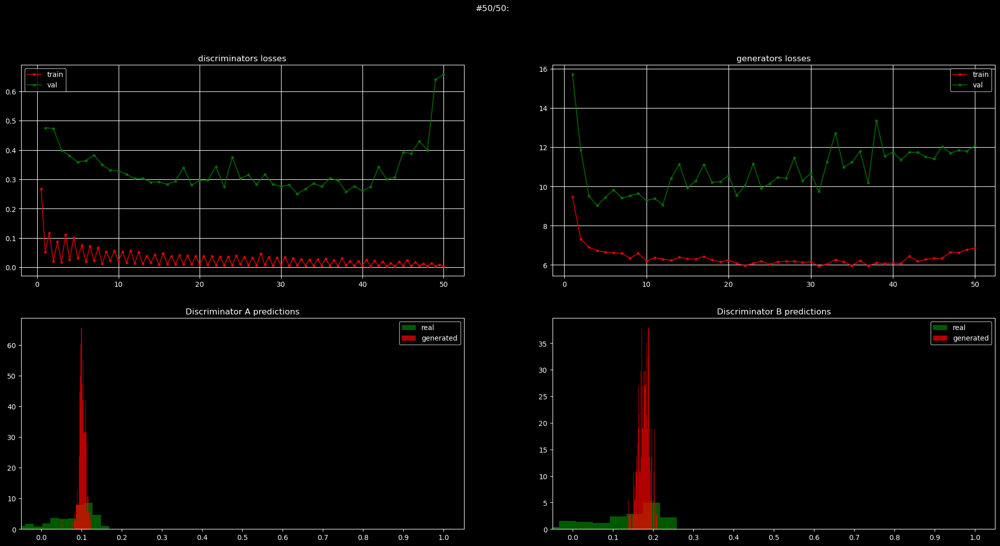

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.0000000000000002].


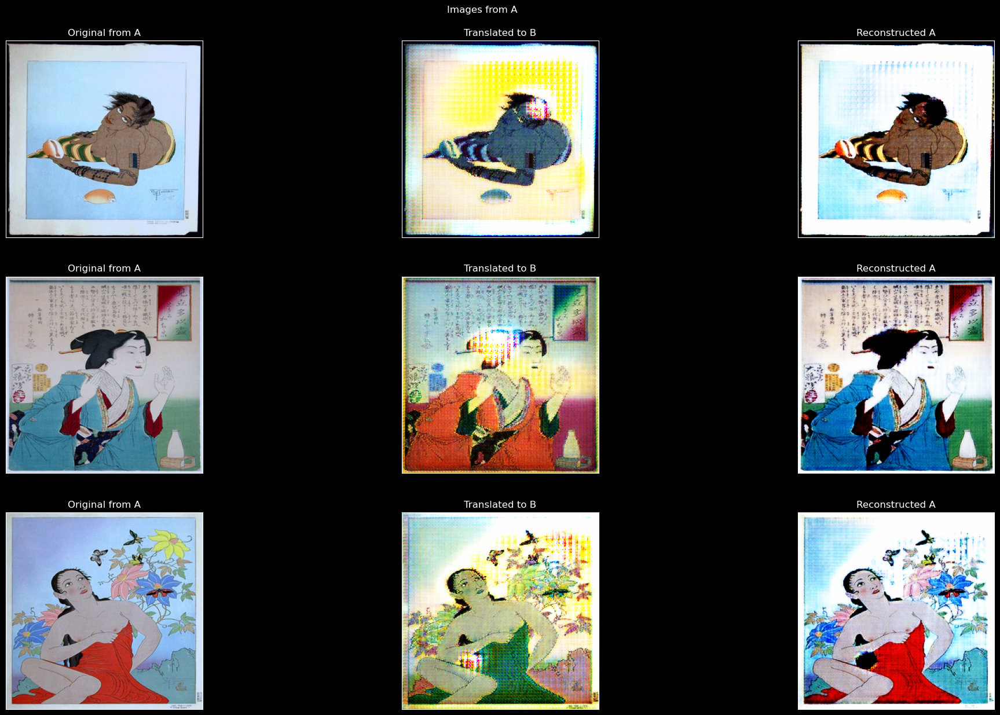

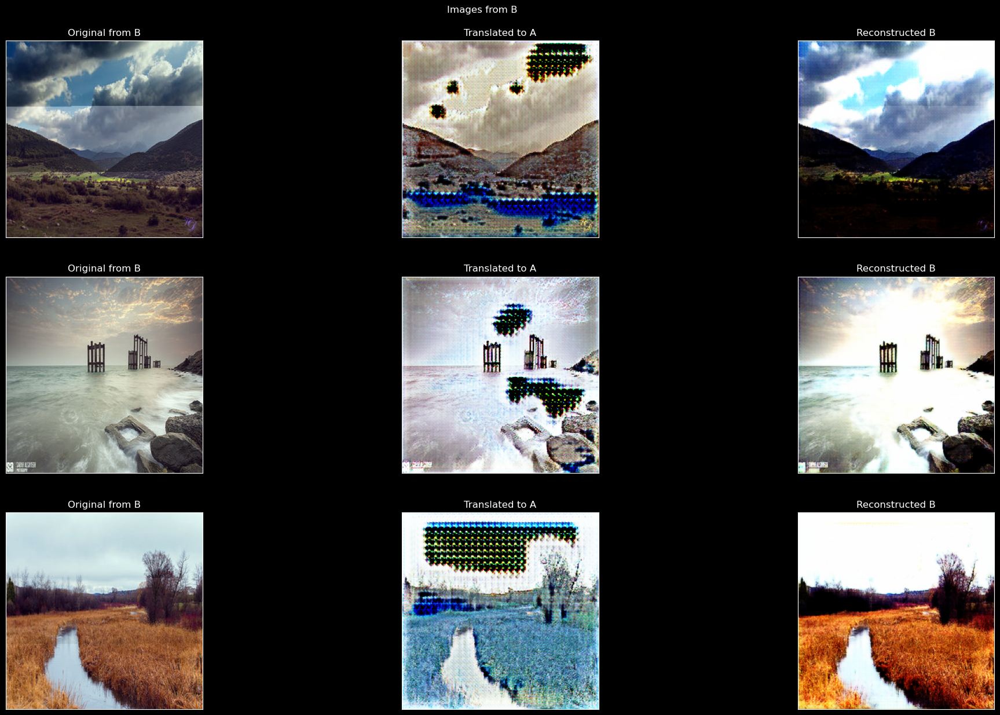

Learning process ended with early stop for generator after epoch 50
CPU times: user 1h 58min 16s, sys: 9min 51s, total: 2h 8min 8s
Wall time: 25min 48s


In [42]:
%%time
model, optimizer_d, optimizer_g, plots = learning_loop(
    model = model,
    optimizer_g = optimizer_g,
    g_iters_per_epoch = 1,
    optimizer_d = optimizer_d,
    d_iters_per_epoch = 2,
    train_loader_a = dataloaders.train_a,
    train_loader_b = dataloaders.train_b,
    val_loader_a = dataloaders.test_a,
    val_loader_b = dataloaders.test_b,
    criterion_d = criterion_d,
    criterion_g = criterion_g,
    scheduler_g = scheduler_g,
    scheduler_d = scheduler_d,
    de_norm_a = de_normalize_a,
    de_norm_b = de_normalize_b,
    epochs = total_epochs,
    min_lr = 1e-6,
    val_every = 1,
    draw_every = 1,
    chkp_folder = "./chkp",
    model_name = f"cycle_gan_{total_epochs}e_ukiyoe2photo",
    images_per_validation=3,
    plots=None,
    starting_epoch=0,
)

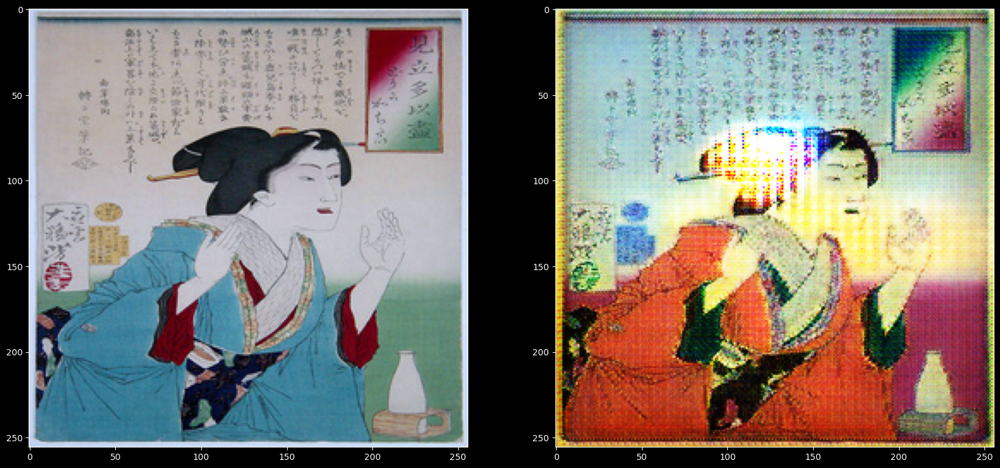

In [43]:
img_a = ds.test_a[1].to(device).unsqueeze(0)

plt.subplots(1, 2, figsize=(20, 10))

plt.subplot(121)
plt.imshow(de_normalize_a(img_a[0]))

plt.subplot(122)
plt.imshow(de_normalize_b(model.G_A(img_a)[0]))

plt.show()

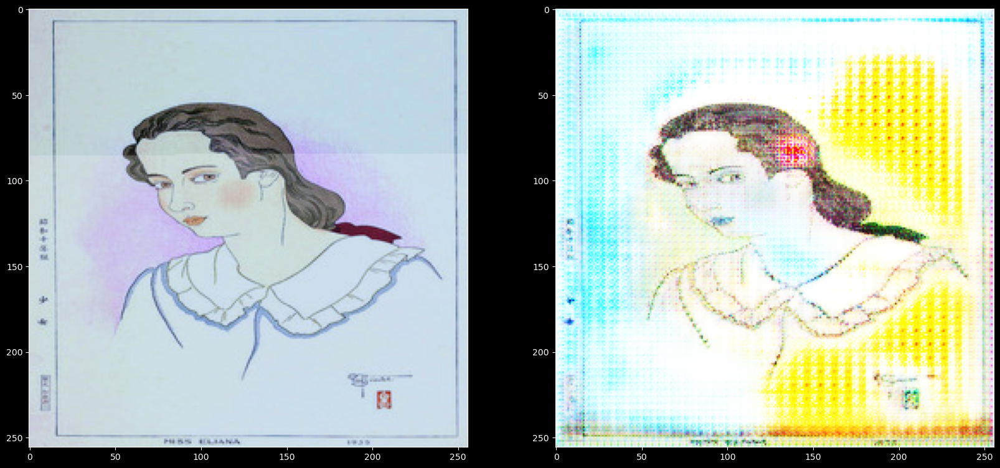

In [44]:
img_a = ds.test_a[5].to(device).unsqueeze(0)

plt.subplots(1, 2, figsize=(20, 10))

plt.subplot(121)
plt.imshow(de_normalize_a(img_a[0]))

plt.subplot(122)
plt.imshow(de_normalize_b(model.G_A(img_a)[0]))

plt.show()

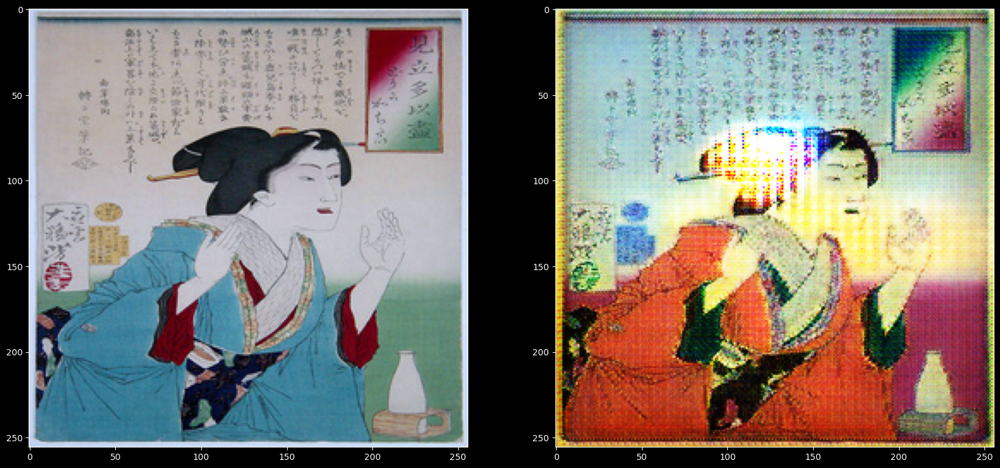

In [45]:
img_ind = 1
img_a = ds.test_a[img_ind].to(device).unsqueeze(0)
fake_b = model.G_A(img_a)

plt.subplots(1, 2, figsize=(20, 10))

plt.subplot(121)
plt.imshow(de_normalize_a(img_a[0]))

plt.subplot(122)
plt.imshow(de_normalize_b(fake_b[0]))

plt.show()

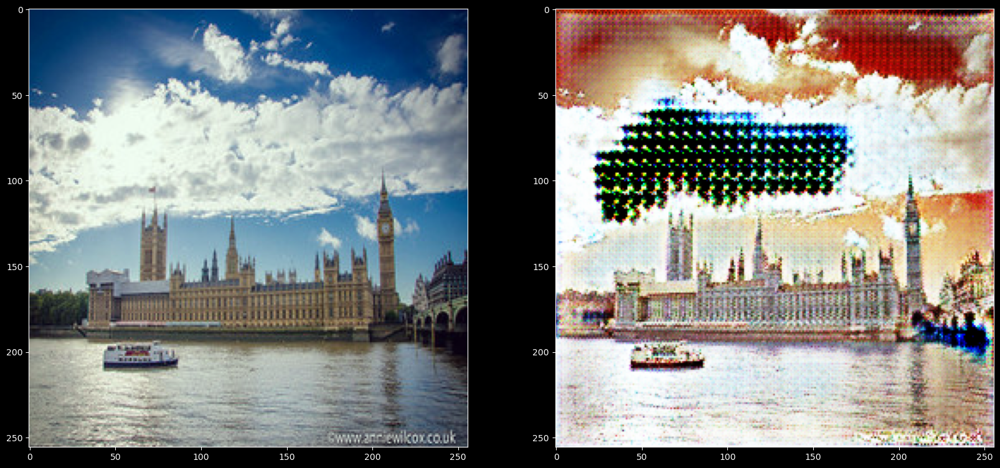

In [46]:
img_ind = 7
img_b = ds.test_b[img_ind].to(device).unsqueeze(0)
fake_a = model.G_B(img_b)

plt.subplots(1, 2, figsize=(20, 10))

plt.subplot(121)
plt.imshow(de_normalize_b(img_b[0]))

plt.subplot(122)
plt.imshow(de_normalize_a(fake_a[0]))

plt.show()

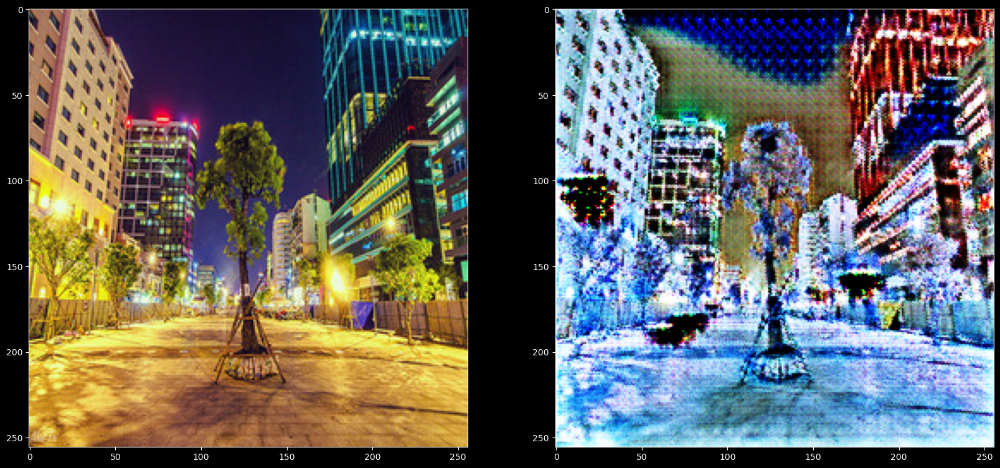

In [ ]:
img_ind = 8
img_b = ds.test_b[img_ind].to(device).unsqueeze(0)
fake_a = model.G_B(img_b)

plt.subplots(1, 2, figsize=(20, 10))

plt.subplot(121)
plt.imshow(de_normalize_b(img_b[0]))

plt.subplot(122)
plt.imshow(de_normalize_a(fake_a[0]))

plt.show()
# А ЧТО ПОХОЖЕ

# 5. Свои данные (___3 балла + бонусы___)

В этой части необходимо выполнить следующее:

1. **Создание датасетов**  
   * Соберите один или пару небольших датасета (минимум 100 примеров, но чем больше, тем лучше).  
   * Дайте волю фантазии, но избегайте неадекватного контента, объема данных или данных за рамками норм.  

2. **Обучение CycleGAN**  
   * Обучите модель CycleGAN для преобразования между вашим датасетом (**домен A**) и другим датасетом (**домен B**).  
   * Второй датасет может быть вашим собственным или любым существующим  

3. **Требования к сдаче**  
   * **Архив с датасетами**:  
     Приложите ссылку на заархивированные данные или загрузите сам архив с данными, использованные для обучения.  
   * **Jupyter Notebook**:  
     * Визуализируйте примеры из доменов A и B с кратким описанием идеи (например, "преобразование эскизов в цветные рисунки").  
     * Добавьте код обучения модели (архитектура, гиперпараметры, функция потерь).  
     * Покажите результаты работы модели (минимум по 5 примеров преобразований A→B и B→A).  
   * **Hugging Face Space + Streamlit**:  
     * Разработайте интерактивное приложение с использованием Streamlit, которое позволяет:  
       - Загружать изображения из доменов A и B.  
       - Отображать результаты преобразований (A→B и B→A) в реальном времени.  
     * Выложите приложение в Hugging Face Space и приложите ссылку на него.  
     * Убедитесь, что модель интегрирована в приложение, а проверяющие могут самостоятельно тестировать её через интерфейс.  

4. **Критерии оценки**  
   * Дополнительные баллы начисляются за:  
     - Креативные и качественные датасеты.  
     - Высокое качество преобразований (четкость, сохранение структуры, отсутствие артефактов).  
     - Удобный и наглядный интерфейс Streamlit-приложения.  

**Примеры идей для датасетов**:  
- Эскизы → Реалистичные изображения.  
- Дневные фото → Ночные фото.  
- Картины в стиле импрессионизма → фотореализм.  

**Важно**:  
- Проверяющий будет оценивать работу через ваше Streamlit-приложение. Убедитесь, что инференс работает стабильно.  
- Если модель слишком велика для деплоя, используйте оптимизацию.  

___Удачи!___ 🚀

In [48]:
# Выбранный выше и скачанный датасет
dataset_folder = "datasets/img2img/"
dataset_name = "fallout3rd2falloutnewvegas"
target_folder = os.path.join(dataset_folder, dataset_name)

# Класс для датасета изображений без лэйблов с применением трансформов
class ImageDatasetNoLabel(Dataset):
    def __init__(self, imgs_path, transforms=None):
        super(ImageDatasetNoLabel).__init__()
        self.images = []
        for filename in tqdm(os.listdir(imgs_path)):
            file_path = os.path.join(imgs_path, filename)
            if filename.lower().endswith(('.jpg')):
                img = cv2.imread(file_path)[:, :, ::-1]
                if transforms is not None:
                    img = transforms(img)
                self.images.append(img)

    def __getitem__(self, index):
        return self.images[index]
    
    def __len__(self):
        return len(self.images)

# Удобный класс для хранения всех наших датасетов
@dataclass
class DatasetsClass:
    train_a: ImageDatasetNoLabel
    train_b: ImageDatasetNoLabel
    test_a: ImageDatasetNoLabel
    test_b: ImageDatasetNoLabel


# Все датасеты без трансформов - чтобы посчитать статистики
ds = DatasetsClass(
    train_a=ImageDatasetNoLabel(os.path.join(target_folder, "trainA")),
    train_b=ImageDatasetNoLabel(os.path.join(target_folder, "trainB")),
    test_a=ImageDatasetNoLabel(os.path.join(target_folder, "testA")),
    test_b=ImageDatasetNoLabel(os.path.join(target_folder, "testB")),
)

100%|██████████| 35/35 [00:00<00:00, 58.79it/s]


In [49]:
# Поканальное среднее и отклонение для A
channel_mean_a, channel_std_a = get_channel_statistics(ds.train_a)
print(channel_mean_a, channel_std_a)

# Поканальное среднее и отклонение для B
channel_mean_b, channel_std_b = get_channel_statistics(ds.train_b)
print(channel_mean_b, channel_std_b)

100%|██████████| 98/98 [00:03<00:00, 28.05it/s]


[0.2999074  0.34460328 0.27964595] [0.26192185 0.27246983 0.239288  ]


100%|██████████| 98/98 [00:02<00:00, 40.20it/s]

[0.40723574 0.35794826 0.27471713] [0.25011656 0.23407436 0.21894803]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.0000000000000002].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.0000000000000002].


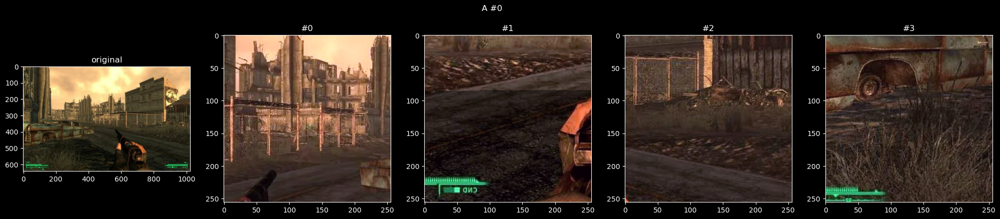

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.0000000000000002].


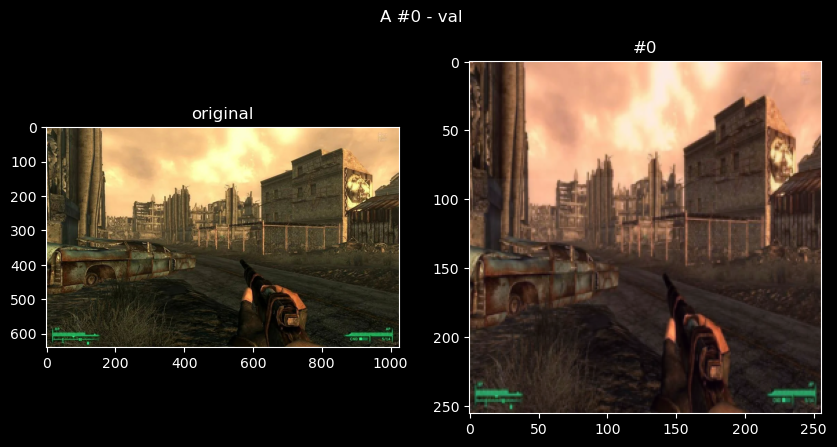

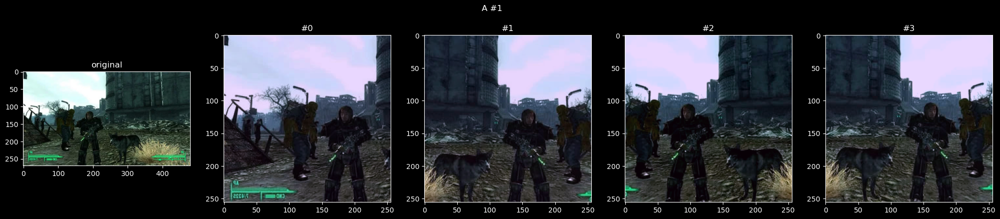

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.0000000000000002].


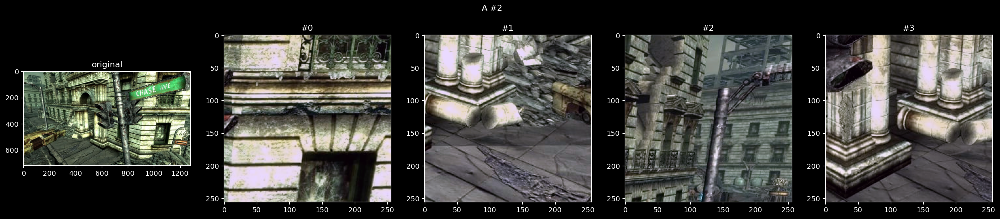

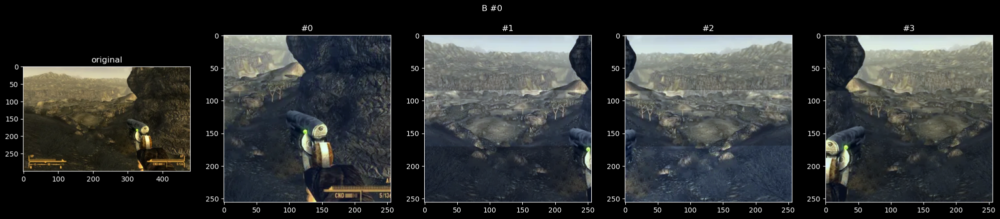

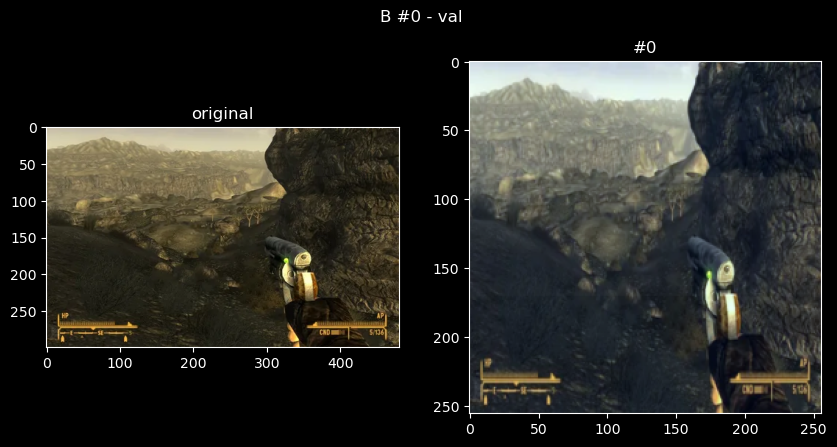

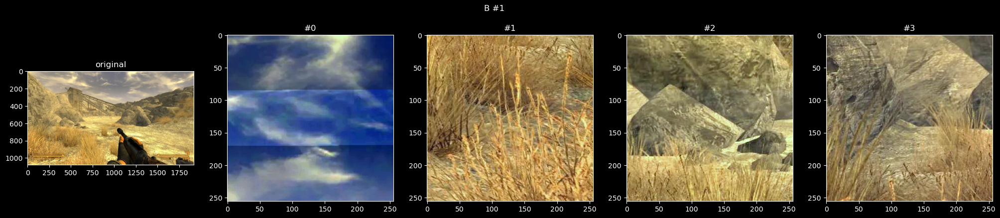

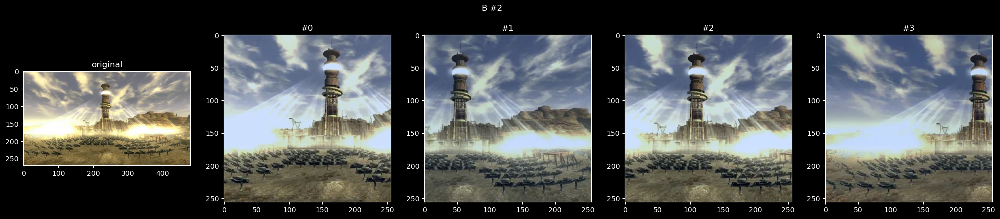

In [50]:
# Функция для получения train и val transform-ов, а так же функции для де-нормализации изображения
def get_transforms(mean, std, random_crop_size, p):
    train_transform = tr.Compose([
        tr.ToPILImage(),
        tr.RandomApply([
            tr.ColorJitter(0.2, 0.2, 0.2, 0.01)  # Изменение яркости, контраста и т.д.
        ], p=0.8),
        v2.RandomCrop(size=random_crop_size),
        v2.RandomHorizontalFlip(p=p),
        tr.ToTensor(),
        tr.Normalize(mean=mean, std=std),
    ])
    
    val_transform = tr.Compose([
        tr.ToPILImage(),
        tr.Resize((random_crop_size, random_crop_size)),
        tr.ToTensor(),
        tr.Normalize(mean=mean, std=std),
    ])
    
    def de_normalize(img, normalized = True):
        with torch.no_grad():
            if normalized:
                img = img.cpu().permute(1,2,0)
                return minmax_scale(
                    (img.reshape(3, -1) + mean[:, None]) * std[:, None],
                    feature_range=(0., 1.),
                    axis=1,
                ).reshape(*img.shape)
            return img

    
    return train_transform, val_transform, de_normalize


# Ваши гиперпараметры
hyperparams = dict(
    random_crop_size = 256,
    p = 0.5
)
# transform-ы для A и B
train_transform_a, val_transform_a, de_normalize_a = get_transforms(channel_mean_a, channel_std_a, **hyperparams)
train_transform_b, val_transform_b, de_normalize_b = get_transforms(channel_mean_b, channel_std_b, **hyperparams)


# Функция для визуализации transform-ов
def show_examples(dataset, transform, de_norm, num_per_image=3, image_index=0, title=""):
    fig, ax = plt.subplots(1, 1 + num_per_image, figsize=(5 * (1 + num_per_image), 5))
    
    image = dataset[image_index]
    
    plt.suptitle(title, y=0.95)

    plt.subplot(1, 1 + num_per_image, 1)
    plt.imshow(image)
    plt.title("original")

    for i in range(num_per_image):
        plt.subplot(1, 1 + num_per_image, i + 2)
        plt.title(f"#{i}")
        plt.imshow(de_norm(transform(image)))
    plt.show()

# Проверка на адекватность
show_examples(ds.train_a, train_transform_a, de_normalize_a, num_per_image=4, image_index=0, title="A #0")
show_examples(ds.train_a, val_transform_a, de_normalize_a, num_per_image=1, image_index=0, title="A #0 - val")
show_examples(ds.train_a, train_transform_a, de_normalize_a, num_per_image=4, image_index=1, title="A #1")
show_examples(ds.train_a, train_transform_a, de_normalize_a, num_per_image=4, image_index=2, title="A #2")
show_examples(ds.train_b, train_transform_b, de_normalize_b, num_per_image=4, image_index=0, title="B #0")
show_examples(ds.train_b, val_transform_b, de_normalize_b, num_per_image=1, image_index=0, title="B #0 - val")
show_examples(ds.train_b, train_transform_b, de_normalize_b, num_per_image=4, image_index=1, title="B #1")
show_examples(ds.train_b, train_transform_b, de_normalize_b, num_per_image=4, image_index=2, title="B #2")

In [50]:
# Все датасеты с трансформами
ds = DatasetsClass(
    train_a=ImageDatasetNoLabel(
        os.path.join(target_folder, "trainA"),
        transforms=train_transform_a,
    ),
    train_b=ImageDatasetNoLabel(
        os.path.join(target_folder, "trainB"),
        transforms=val_transform_b,
    ),
    test_a=ImageDatasetNoLabel(
        os.path.join(target_folder, "testA"),
        transforms=val_transform_a,
    ),
    test_b=ImageDatasetNoLabel(
        os.path.join(target_folder, "testB"),
        transforms=val_transform_b,
    ),
)

100%|██████████| 35/35 [00:00<00:00, -41.30it/s]


In [51]:
@dataclass
class DataLoadersClass:
    train_a: DataLoader
    train_b: DataLoader
    test_a: DataLoader
    test_b: DataLoader

batch_size = 2

dataloaders = DataLoadersClass(
    train_a=DataLoader(
        dataset=ds.train_a,
        batch_size=batch_size,
        shuffle=True,
        drop_last=True,
    ),
    train_b=DataLoader(
        dataset=ds.train_b,
        batch_size=batch_size,
        shuffle=True,
        drop_last=True,
    ),
    test_a=DataLoader(
        dataset=ds.test_a,
        batch_size=batch_size,
        shuffle=False,
        drop_last=True,
    ),
    test_b=DataLoader(
        dataset=ds.test_b,
        batch_size=batch_size,
        shuffle=False,
        drop_last=True,
    ),
)

In [52]:
total_epochs = 200
half_epochs = total_epochs/2

In [53]:
device = torch.device('cuda:0') if torch.cuda.is_available() else torch.device('cpu')
from torch.optim.lr_scheduler import LambdaLR
from torch.optim.lr_scheduler import StepLR

def get_linear_scheduler(optimizer, start_epoch, n_epochs):
    def lr_lambda(epoch):
        return 1.0 - max(0, epoch - start_epoch) / (n_epochs - start_epoch)
    return LambdaLR(optimizer, lr_lambda)


results = []

model_params = dict()

model, optimizer_d, optimizer_g = create_model_and_optimizer(
    model_class = CycleGAN,
    model_params = model_params,
    lr_d = 1e-3,
    lr_g = 1e-3,
    device = device,
)

scheduler_d = StepLR(optimizer_d, step_size=10, gamma=0.99)
# scheduler_g = StepLR(optimizer_g, step_size=10, gamma=0.99)
# Использование:
# scheduler_d = get_linear_scheduler(optimizer_d, start_epoch=2*half_epochs, n_epochs=total_epochs)
scheduler_g = get_linear_scheduler(optimizer_g, start_epoch=half_epochs, n_epochs=total_epochs)

criterion_d = FullDiscriminatorLoss()
criterion_g = FullGeneratorLoss(lambda_value=10.)

sum_params, sum_learnable_params = model_num_params(model)

D_A.model.0.weight                                                ~  3.072     params ~ grad: True
D_A.model.0.bias                                                  ~  64        params ~ grad: True
D_A.model.2.weight                                                ~  131.072   params ~ grad: True
D_A.model.3.weight                                                ~  128       params ~ grad: True
D_A.model.3.bias                                                  ~  128       params ~ grad: True
D_A.model.5.weight                                                ~  524.288   params ~ grad: True
D_A.model.6.weight                                                ~  256       params ~ grad: True
D_A.model.6.bias                                                  ~  256       params ~ grad: True
D_A.model.8.weight                                                ~  2.097.152 params ~ grad: True
D_A.model.9.weight                                                ~  512       params ~ grad: True
D_A.model.

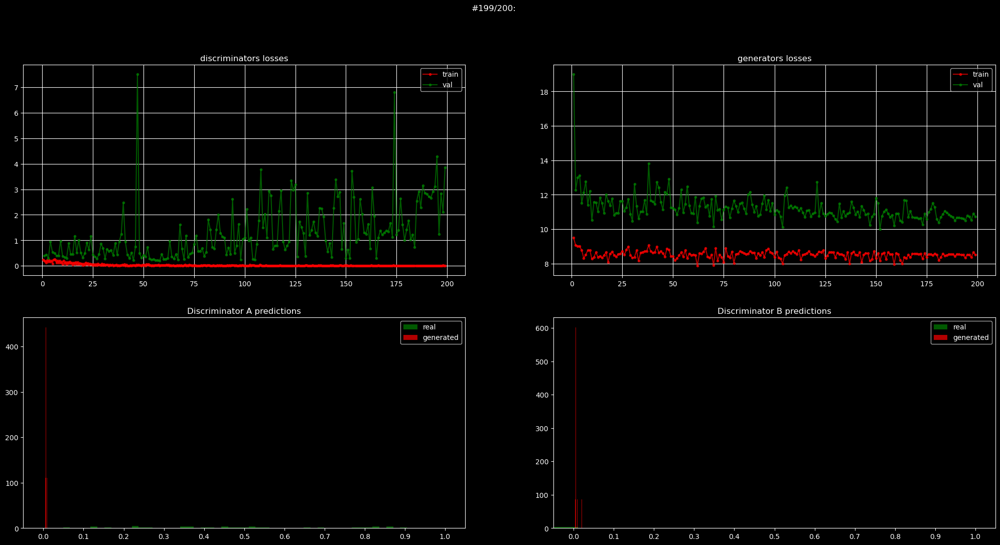

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.0000000000000002].


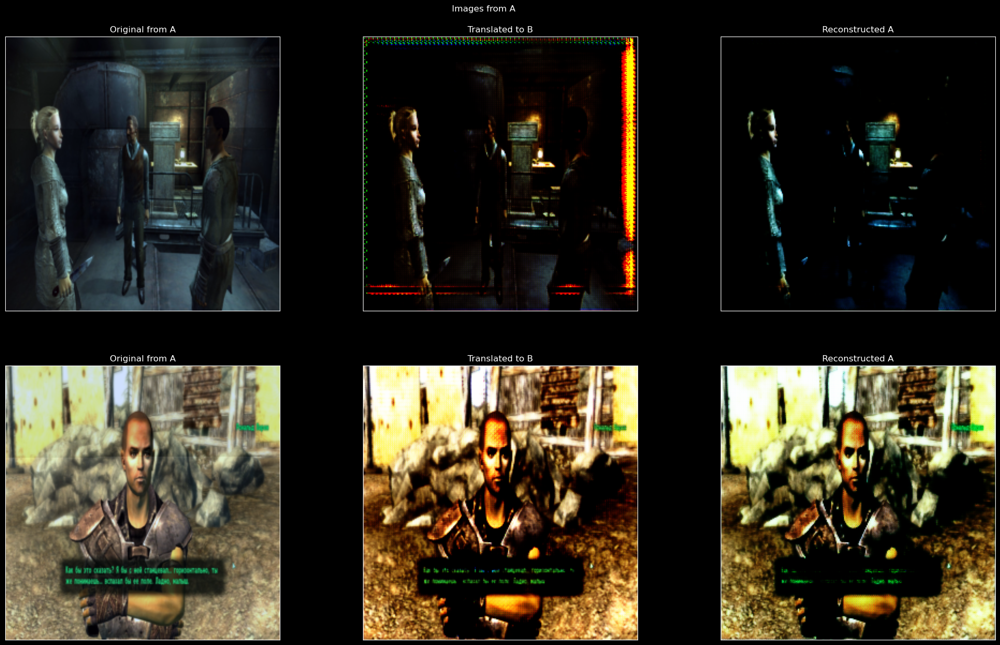

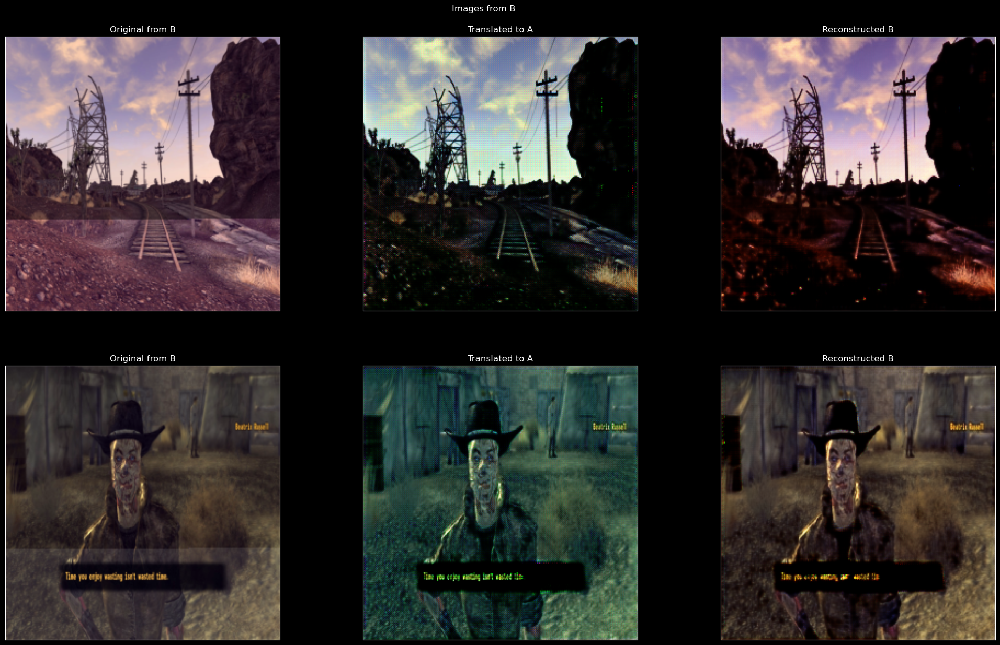

Learning process ended with early stop for generator after epoch 199
CPU times: user 2h 24min 30s, sys: 10min 15s, total: 2h 34min 46s
Wall time: 31min 32s


In [56]:
%%time
model, optimizer_d, optimizer_g, plots = learning_loop(
    model = model,
    optimizer_g = optimizer_g,
    g_iters_per_epoch = 1,
    optimizer_d = optimizer_d,
    d_iters_per_epoch = 2,
    train_loader_a = dataloaders.train_a,
    train_loader_b = dataloaders.train_b,
    val_loader_a = dataloaders.test_a,
    val_loader_b = dataloaders.test_b,
    criterion_d = criterion_d,
    criterion_g = criterion_g,
    scheduler_g = scheduler_g,
    scheduler_d = scheduler_d,
    de_norm_a = de_normalize_a,
    de_norm_b = de_normalize_b,
    epochs = total_epochs,
    min_lr = 1e-6,
    val_every = 1,
    draw_every = 1,
    chkp_folder = "./chkp",
    model_name = f"cycle_gan_{total_epochs}e_fallout",
    images_per_validation=2,
    plots=None,
    starting_epoch=0,
)

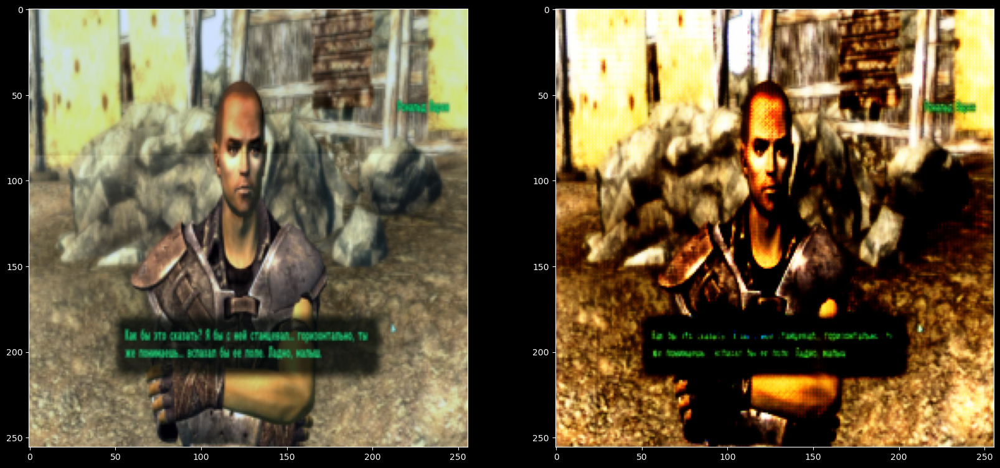

In [57]:
img_a = ds.test_a[1].to(device).unsqueeze(0)

plt.subplots(1, 2, figsize=(20, 10))

plt.subplot(121)
plt.imshow(de_normalize_a(img_a[0]))

plt.subplot(122)
plt.imshow(de_normalize_b(model.G_A(img_a)[0]))

plt.show()

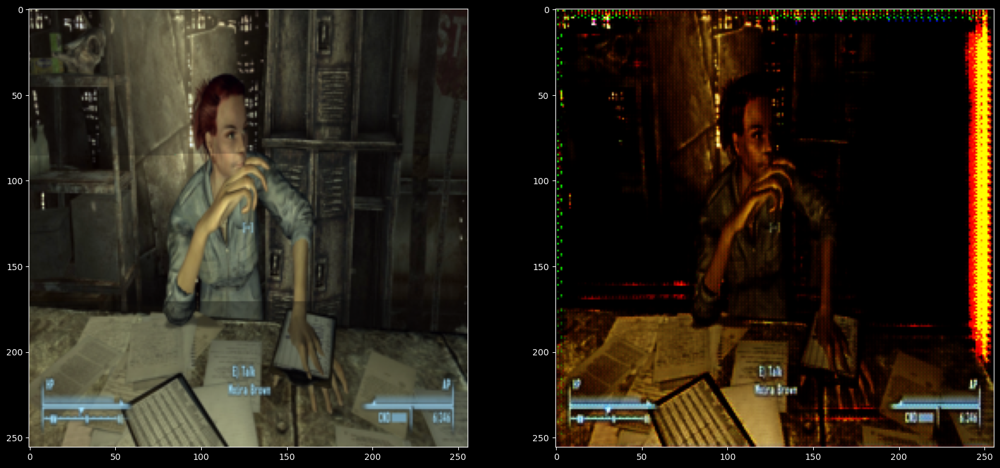

In [58]:
img_a = ds.test_a[5].to(device).unsqueeze(0)

plt.subplots(1, 2, figsize=(20, 10))

plt.subplot(121)
plt.imshow(de_normalize_a(img_a[0]))

plt.subplot(122)
plt.imshow(de_normalize_b(model.G_A(img_a)[0]))

plt.show()

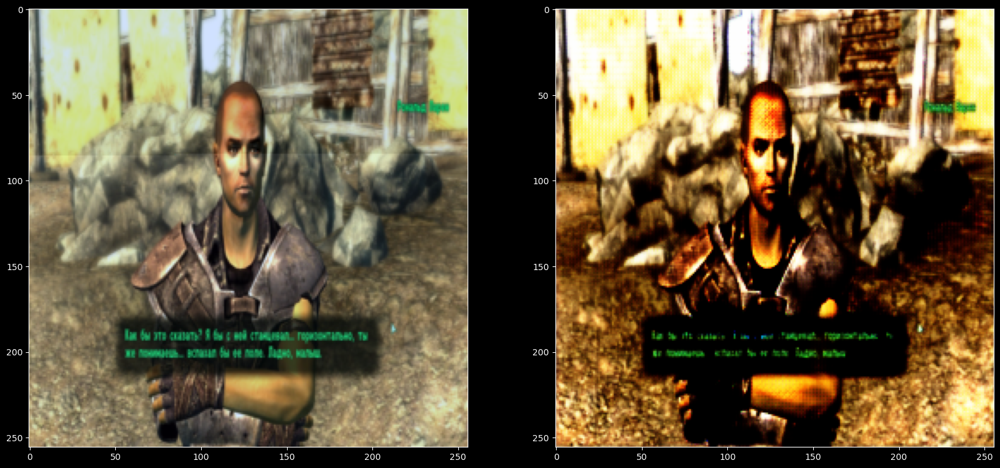

In [59]:
img_ind = 1
img_a = ds.test_a[img_ind].to(device).unsqueeze(0)
fake_b = model.G_A(img_a)

plt.subplots(1, 2, figsize=(20, 10))

plt.subplot(121)
plt.imshow(de_normalize_a(img_a[0]))

plt.subplot(122)
plt.imshow(de_normalize_b(fake_b[0]))

plt.show()

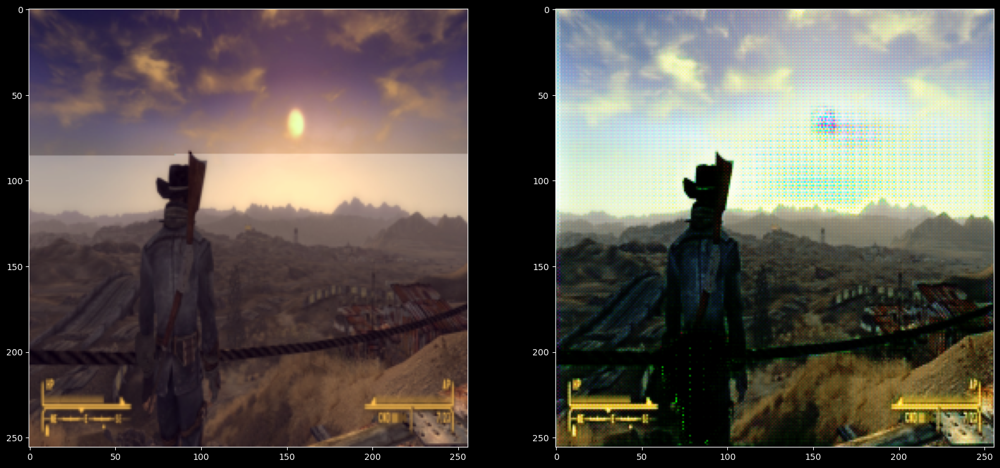

In [60]:
img_ind = 7
img_b = ds.test_b[img_ind].to(device).unsqueeze(0)
fake_a = model.G_B(img_b)

plt.subplots(1, 2, figsize=(20, 10))

plt.subplot(121)
plt.imshow(de_normalize_b(img_b[0]))

plt.subplot(122)
plt.imshow(de_normalize_a(fake_a[0]))

plt.show()